# Bayesian inversion of diffusivity in Poisson equation

In [35]:
import sys
import os
import time
import numpy as np
import dolfin as dl

import torch

from scipy.interpolate import griddata

model_path = "../../problems/poisson/"
sys.path.append(model_path)
from poissonModel import PoissonModel

util_path = "../../utilities/"
sys.path.append(util_path)
from plotUtilities import *
from priorSampler import PriorSampler
from fenicsUtilities import vertex_to_function, function_to_vertex
from dataMethods import DataProcessor
from torch_deeponet import DeepONet

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# set seed
seed = 0
np.random.seed(seed)

In [36]:
model_data_folder = model_path + 'data/'
current_directory = os.getcwd()  
results_dir = current_directory + '/Results/'
if not os.path.exists(results_dir):
    os.makedirs(results_dir)

# Plotting functions

In [37]:
def plot_curve(data, x = None, xl = None, yl = None, \
               fs = 20, lw = 2, lclr = 'tab:blue', \
               l_lbl = None, \
               title = None, \
         savefig = False, savefile = '', figsize = [10,10]):
    
    fig, ax = plt.subplots(figsize=figsize)

    if x is not None:
        if l_lbl is not None:
            ax.plot(x, data, lw = lw, color = lclr, label = l_lbl)
        else:
            ax.plot(x, data, lw = lw, color = lclr)
    else:
        ax.plot(data)
    if xl is not None:
        ax.set_xlabel(xl, fontsize = fs)
    if yl is not None:
        ax.set_ylabel(yl, fontsize = fs)

    if l_lbl is not None:
        ax.legend(fontsize = fs, fancybox = True, frameon = True)

    if title is not None:
        ax.set_title(title, fontsize = fs)
        
    plt.tight_layout(pad=0.4)
    if savefig:
        plt.savefig(savefile)
    plt.show()

In [38]:
def plot_fields_base(w_mean, w_sample, w_sample_i, mcmc, savefilename = None):

    model, prior_sampler, ground_truth_data, x_obs = mcmc.model, mcmc.prior, mcmc.data, mcmc.x_obs

    m_mean = mcmc.model.transform_gaussian_pointwise(w_mean)
    u_mean = mcmc.model.solveFwd(u = None, m = m_mean, transform_m = False)
    
    
    m_sample = mcmc.model.transform_gaussian_pointwise(w_sample)
    u_sample = mcmc.model.solveFwd(u = None, m = m_sample, transform_m = False)

    u_mean_obs = mcmc.state_to_obs(u_mean)
    u_sample_obs = mcmc.state_to_obs(u_sample)

    w_true, m_true, u_true = mcmc.data['w_true'], mcmc.data['m_true'], mcmc.data['u_true'] 
    u_obs = mcmc.data['u_obs']

    rows, cols = 3, 4
    fig, axs = plt.subplots(rows, cols, figsize=(20, 12))
    axs = np.array([axs]) if rows == 1 else axs

    uvec = [[w_true, m_true, u_true, u_obs], \
            [w_sample, m_sample, u_sample, u_sample_obs], \
            [w_mean, m_mean, u_mean, u_mean_obs]]
        
    title_vec = [ [ r'$w_{true} \sim N(0, C)$', \
                    r'$m_{true} = a\, \exp(w_{true}) + b$', \
                    r'$u_{true} = F(m_{true})$', \
                    r'$u_{obs}$' \
                    ], \
                    [ r'$w_{sample} \sim N(0, C)$', \
                    r'$m_{sample} = a\, \exp(w_{sample}) + b$', \
                    r'$u_{sample} = F(m_{sample})$', \
                    r'$u_{sample, obs}$' \
                    ], \
                    [ r'$w_{mean} \sim N(0, C)$', \
                    r'$m_{mean} = a\, \exp(w_{mean}) + b$', \
                    r'$u_{mean} = F(m_{mean})$', \
                    r'$u_{mean, obs}$' \
                ]]
        
    cmap_vec = [['magma', 'jet', 'viridis', 'copper'] \
                    for i in range(rows)]
    
    sup_title = r'Ground truth, $i^{th}$ sample' \
            + r', and posterior mean $(w, m, u(m), u_{obs})$' \
            + r', i = {}'.format(w_sample_i)

    fs = 25
    y_sup_title = 1.075

    nodes = model.m_nodes


    for i in range(rows):
        for j in range(cols):

            # add grid points
            if j == cols - 1:
                axs[i,j].set_xlim([-0.1, 1.1])
                axs[i,j].set_ylim([-0.1, 1.1])
            
            if j < cols - 1:
                cbar = field_plot(axs[i,j], \
                    uvec[i][j], \
                    nodes, cmap = cmap_vec[i][j])
            else:
                uob = uvec[i][j]
                cbar = point_plot(axs[i,j], uob, x_obs, cmap = cmap_vec[i][j])
            divider = make_axes_locatable(axs[i,j])
            cax = divider.append_axes('right', size='8%', pad=0.03)
            cax.tick_params(labelsize=fs)
            cbar = fig.colorbar(cbar, cax=cax, orientation='vertical')
            if j < cols - 1:
                axs[i,j].axis('off')
            if title_vec is not None:
                tt = title_vec[i][j]
                if i > 0:
                    u1, u2 = uvec[0][j], uvec[i][j]
                    err = np.linalg.norm(u1 - u2)/np.linalg.norm(u1)
                    tt += '\n' + r'err (l2 rel) = {:.2f}%'.format(err)
                axs[i,j].set_title(tt, fontsize=fs, pad=10)

    fig.tight_layout()
    if sup_title is not None:
        fig.suptitle(sup_title, fontsize=1.25*fs, y = y_sup_title)
    if savefilename is not None:
        plt.savefig(savefilename,  bbox_inches='tight')
    plt.show()

def plot_fields(mcmc, savefilename = None):

    w_mean = mcmc.tracer.accepted_samples_mean_m
    w_sample_i = len(mcmc.tracer.accepted_samples_m) - 1
    w_sample = mcmc.tracer.accepted_samples_m[w_sample_i]

    plot_fields_base(w_mean, w_sample, w_sample_i, mcmc, savefilename)
    

In [39]:
def compute_sample_errors(mcmc):
    n = 4
    true_vec = [mcmc.data['w_true'], mcmc.data['m_true'], mcmc.data['u_true'], mcmc.data['u_obs']]
    true_vec_norm = [np.linalg.norm(true_vec[i]) for i in range(4)] 

    w_mean = mcmc.tracer.accepted_samples_mean_m
    m_mean = mcmc.model.transform_gaussian_pointwise(w_mean)
    u_mean = mcmc.model.solveFwd(u = None, m = m_mean, transform_m = False)
    u_obs_mean = mcmc.state_to_obs(u_mean)
    mean_vec = [w_mean, m_mean, u_mean, u_obs_mean]
    
    mean_err_vec_norm = [100*np.linalg.norm(mean_vec[i] \
            - true_vec[i])/true_vec_norm[i] for i in range(4)]
    
    w_sample = mcmc.tracer.accepted_samples_m[-1]
    m_sample = mcmc.model.transform_gaussian_pointwise(w_sample)
    u_sample = mcmc.model.solveFwd(u = None, m = m_sample, transform_m = False)
    u_obs_sample = mcmc.state_to_obs(u_sample)
    sample_vec = [w_sample, m_sample, u_sample, u_obs_sample]
    
    sample_err_vec_norm = [100*np.linalg.norm(sample_vec[i] \
            - true_vec[i])/true_vec_norm[i] for i in range(4)]

    err_tag = ['w', 'm', 'u', 'u_obs']
    rs = []
    for i in range(4):
        me = '||{} - {}_mean|| = {:.3e}'.format(err_tag[i], \
            err_tag[i], mean_err_vec_norm[i])
        se = '||{} - {}_sample|| = {:.3e}'.format(err_tag[i], \
            err_tag[i], sample_err_vec_norm[i])
        
        rs.append('Error (%) in {}: {}, {}'.format(err_tag[i], \
            me, se))
        
    s = rs[0]
    for i in range(1, len(rs)):
        s += '\n' + rs[i]
    return s

# Create PoissonModel

In [40]:
gamma = 0.005
delta = 0.2
logn_scale = 1
logn_translate = 0.
nx, ny = 50, 50
fe_order = 1
data_prefix = 'Poisson'

# create mesh
mesh = dl.UnitSquareMesh(nx, ny)

# create function spaces
Vm = dl.FunctionSpace(mesh, 'Lagrange', fe_order)
Vu = Vm

# create prior sampler
prior_sampler = PriorSampler(Vm, gamma, delta, seed)

# create model
model = PoissonModel(Vm, Vu, prior_sampler, logn_scale, logn_translate, seed)

# Load Neural Operators

## DeepONet

In [41]:
# load the data
deeponet_data = DataProcessor(model_path + 'data/' + data_prefix + '_samples.npz', num_train = 3400, num_test = 600, num_inp_fn_points = 2601, num_out_fn_points = 2601, num_Y_components = 1)

# load the model
deeponet = torch.load(model_path \
                + 'DeepONet/Results_implement2/DeepONet/model.pkl')

print('Model:', model)

Model: <poissonModel.PoissonModel object at 0x761068b4ca90>


/tmp/ipykernel_1410390/2716312232.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  deeponet = torch.load(model_path \


In [42]:
%%time
m1 = model.samplePrior(transform_m = True)
m2 = m1.copy()


CPU times: user 1.1 s, sys: 3.75 ms, total: 1.1 s
Wall time: 41.9 ms


In [43]:
%%time
u_dn = deeponet_data.decoder_Y(deeponet.predict(deeponet_data.encoder_X(m1), deeponet_data.X_trunk).detach().numpy())

CPU times: user 4.9 s, sys: 145 ms, total: 5.04 s
Wall time: 140 ms


In [44]:
%%time
u_model = model.solveFwd(u = None, m = m2, transform_m = False)

CPU times: user 3.32 s, sys: 111 ms, total: 3.43 s
Wall time: 91.2 ms


# Get ground truth

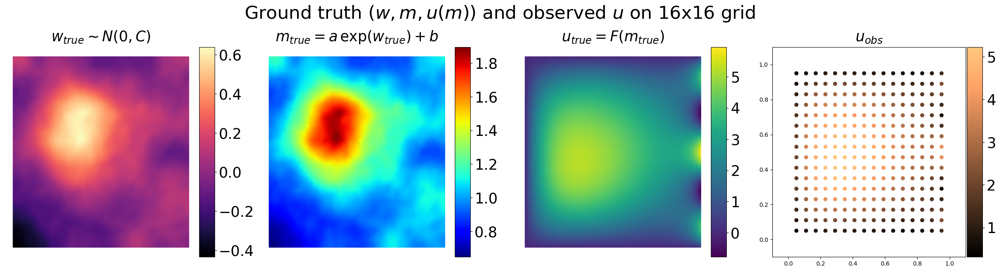

In [45]:
# load
ground_truth_data = np.load(results_dir + 'ground_truth/data.npz')
num_grid_x, num_grid_y = ground_truth_data['num_grid_x'], ground_truth_data['num_grid_y']
w_true = ground_truth_data['w_true']
m_true = ground_truth_data['m_true']
u_true = ground_truth_data['u_true']
x_obs = ground_truth_data['x_obs']
u_obs = ground_truth_data['u_obs']


rows, cols = 1, 4
fig, axs = plt.subplots(rows, cols, figsize=(24, 6))
axs = np.array([axs]) if rows == 1 else axs

uvec = [[w_true, m_true, u_true]]
title_vec = [[r'$w_{true} \sim N(0, C)$', r'$m_{true} = a\, \exp(w_{true}) + b$', r'$u_{true} = F(m_{true})$', r'$u_{obs}$']]
cmap_vec = [['magma', 'jet', 'viridis', 'copper']]
sup_title = r'Ground truth $(w, m, u(m))$ and observed $u$ on {}x{} grid'.format(num_grid_x, num_grid_y)
fs = 25
y_sup_title = 1.075
savefilename = results_dir + 'true_and_obs_w_m_u.png'

nodes = model.Vm.mesh().coordinates()


for i in range(rows):
    for j in range(cols):

        # add grid points
        if j == cols - 1:
            axs[i,j].set_xlim([-0.1, 1.1])
            axs[i,j].set_ylim([-0.1, 1.1])
        
        if j < cols - 1:
            cbar = field_plot(axs[i,j], \
                uvec[i][j], \
                nodes, cmap = cmap_vec[i][j])
        else:
            cbar = point_plot(axs[i,j], u_obs, x_obs, cmap = cmap_vec[i][j])
        divider = make_axes_locatable(axs[i,j])
        cax = divider.append_axes('right', size='8%', pad=0.03)
        cax.tick_params(labelsize=fs)
        cbar = fig.colorbar(cbar, cax=cax, orientation='vertical')
        if j < cols - 1:
            axs[i,j].axis('off')
        if title_vec is not None:
            axs[i,j].set_title(title_vec[i][j], fontsize=fs, pad=10)        

fig.tight_layout()
if sup_title is not None:
    fig.suptitle(sup_title, fontsize=1.25*fs, y = y_sup_title)
if savefilename is not None:
    plt.savefig(savefilename,  bbox_inches='tight')
plt.show()

## Compute noise

In [61]:
u_obs_mean, u_obs_std = np.mean(u_obs), np.std(u_obs)
sigma_noise = 0.05 * u_obs_mean
print('u_obs_mean = {:.3e}, u_obs_std = {:.3e}, sigma_noise: {:.3e}'.format(u_obs_mean, u_obs_std, sigma_noise))

u_obs_mean = 2.785e+00, u_obs_std = 1.329e+00, sigma_noise: 1.393e-01


# Bayesian parameter estimation setup

In [62]:
# Create an MCMC class that takes model, prior, and data and
# model -> provides a method solveFwd() that solves the forward problem for a input m
# prior -> provides a method logPrior() that returns the log prior
# data -> provides the observations and the points at which observations are made
# The class then implements the following functions
# solveFwd(self, m) -> solves the forward problem for a given m
# logLikelihood(self, m) -> returns the log-likelihood (i.e., cost or misfit)
# logPosterior(self, m) -> returns the log posterior (cost + log-prior)
# sample(self,m) -> generate next sample given the current sample (modifies m if needed)
# proposal(self, m) -> returns the next sample given the current sample (does not modify m)
# run(self) -> runs the MCMC algorithm usign Metroplis-Hastings together with preconditioned Crank-Nicolson
# save(self) -> saves the samples, log-likelihood, log-posterior, and the chain and prints the details such as cost, acceptances, etc.

class State:

    def __init__(self, m_dim, u_dim, u_obs_dim):
        self.m = np.zeros(m_dim)
        self.u = np.zeros(u_dim)
        self.u_obs_dim = u_obs_dim
        self.u_obs = np.zeros(u_obs_dim)
        self.err_obs = np.zeros(u_obs_dim)
        self.log_likelihood = 0
        self.log_posterior = 0
        self.log_prior = 0
        self.cost = 0

    def set(self, a):
        self.m = a.m.copy()
        self.u = a.u.copy()
        self.u_obs = a.u_obs.copy()
        self.err_obs = a.err_obs.copy()
        self.log_likelihood = a.log_likelihood
        self.log_posterior = a.log_posterior
        self.log_prior = a.log_prior
        self.cost = a.cost

class Tracer:

    def __init__(self, mcmc):
        self.mcmc = mcmc

        self.init_m = np.zeros(self.mcmc.m_dim)
        self.init_u = np.zeros(self.mcmc.u_dim)
        self.init_u_obs = np.zeros(self.mcmc.u_obs_dim)

        self.accepted_samples_m = np.zeros((1, self.mcmc.m_dim))
        self.accepted_samples_u = np.zeros((1, self.mcmc.u_dim))

        self.accepted_samples_mean_m = np.zeros(self.mcmc.m_dim)
        self.accepted_samples_std_m = np.zeros(self.mcmc.m_dim)
        self.accepted_samples_mean_u = np.zeros(self.mcmc.u_dim)
        self.accepted_samples_std_u = np.zeros(self.mcmc.u_dim)
        
        self.accepted_samples_obs_u = np.zeros((1, self.mcmc.u_obs_dim))
        self.accepted_samples_obs_mean_u = np.zeros(self.mcmc.u_obs_dim)
        self.accepted_samples_obs_err = np.zeros((1, self.mcmc.u_obs_dim))
        self.accepted_samples_obs_err_mean = np.zeros(self.mcmc.u_obs_dim)

        self.accepted_samples_log_likelihood = np.zeros(1)
        self.accepted_samples_log_posterior = np.zeros(1)
        self.accepted_samples_log_prior = np.zeros(1)
        self.accepted_samples_cost = np.zeros(1)

        self.accepted_samples_log_likelihood_mean = 0
        self.accepted_samples_log_posterior_mean = 0
        self.accepted_samples_log_prior_mean = 0
        self.accepted_samples_cost_mean = 0
        
        self.current_acceptance_rate = 0
        self.acceptances = 0
        self.acceptance_rate = np.zeros(1)
        self.accep_reject_record = np.zeros(1)

        self.append_sample_i = 0

        # save related
        self.savepath = './'
        self.savefilename = self.savepath + 'mcmc_results.npz'
        self.save_every = 10
        self.statistics_every = 10

        # logging
        self.print_every = 10
        self.print_lvl = 1
        self.display_plot_every = self.print_every

    def init(self, current, init_sample):
        self.init_m = init_sample.m.copy()
        self.init_u = init_sample.u.copy()
        self.init_u_obs = init_sample.u_obs.copy()

        self.accepted_samples_m[0] = current.m
        self.accepted_samples_u[0] = current.u
        self.accepted_samples_obs_u[0] = current.u_obs
        self.accepted_samples_obs_err[0] = current.err_obs
        self.accepted_samples_log_likelihood[0] = current.log_likelihood
        self.accepted_samples_log_posterior[0] = current.log_posterior
        self.accepted_samples_log_prior[0] = current.log_prior
        self.accepted_samples_cost[0] = current.cost

    def stats(self):
        # compute statistics
        self.accepted_samples_mean_m = np.mean(self.accepted_samples_m, axis = 0)
        self.accepted_samples_std_m = np.std(self.accepted_samples_m, axis = 0)
        self.accepted_samples_mean_u = np.mean(self.accepted_samples_u, axis = 0)
        self.accepted_samples_std_u = np.std(self.accepted_samples_u, axis = 0)
        self.accepted_samples_obs_mean_u = np.mean(self.accepted_samples_obs_u, axis = 0)
        self.accepted_samples_obs_err_mean = np.mean(self.accepted_samples_obs_err, axis = 0)
        
        self.accepted_samples_log_likelihood_mean = np.mean(self.accepted_samples_log_likelihood)
        self.accepted_samples_log_posterior_mean = np.mean(self.accepted_samples_log_posterior)
        self.accepted_samples_log_prior_mean = np.mean(self.accepted_samples_log_prior)
        self.accepted_samples_cost_mean = np.mean(self.accepted_samples_cost)


    def append(self, i, current, accept, force_save = False):

        # if we have seen i before, then we will not modify the data but we may need to save if force_save is True
        if i < self.append_sample_i:
            if force_save:
                # update stats
                self.stats()
                # save
                self.save()
            return
        
        self.append_sample_i = i        
        
        # update acceptances
        if accept == 1:
            self.acceptances += 1

        # append new data
        self.current_acceptance_rate = self.acceptances / (i + 1)
        self.acceptance_rate = np.append(self.acceptance_rate, self.current_acceptance_rate)
        self.accep_reject_record = np.append(self.accep_reject_record, accept)

        self.accepted_samples_m = np.vstack((self.accepted_samples_m, current.m))
        self.accepted_samples_u = np.vstack((self.accepted_samples_u, current.u))
        self.accepted_samples_obs_u = np.vstack((self.accepted_samples_obs_u, current.u_obs))
        self.accepted_samples_obs_err = np.vstack((self.accepted_samples_obs_err, current.err_obs))

        self.accepted_samples_log_likelihood = np.append(self.accepted_samples_log_likelihood, current.log_likelihood)
        self.accepted_samples_log_posterior = np.append(self.accepted_samples_log_posterior, current.log_posterior)
        self.accepted_samples_log_prior = np.append(self.accepted_samples_log_prior, current.log_prior)
        self.accepted_samples_cost = np.append(self.accepted_samples_cost, current.cost)
        
        # stats?
        if i % self.statistics_every == 0: 
            self.stats()

        # save?
        if i % self.save_every == 0:
            self.save()

    def save(self):
        # save the data
        np.savez(self.savefilename + '.npz', \
            init_m = self.init_m, \
            init_u = self.init_u, \
            init_u_obs = self.init_u_obs, \
            accepted_samples_m = self.accepted_samples_m, \
            accepted_samples_u = self.accepted_samples_u, \
            accepted_samples_obs_u = self.accepted_samples_obs_u, \
            accepted_samples_obs_err = self.accepted_samples_obs_err, \
            accepted_samples_log_likelihood = self.accepted_samples_log_likelihood, \
            accepted_samples_log_posterior = self.accepted_samples_log_posterior, \
            accepted_samples_log_prior = self.accepted_samples_log_prior, \
            accepted_samples_cost = self.accepted_samples_cost, \
            accepted_samples_mean_m = self.accepted_samples_mean_m, \
            accepted_samples_std_m = self.accepted_samples_std_m, \
            accepted_samples_mean_u = self.accepted_samples_mean_u, \
            accepted_samples_std_u = self.accepted_samples_std_u, \
            accepted_samples_obs_mean_u = self.accepted_samples_obs_mean_u, \
            accepted_samples_obs_err_mean = self.accepted_samples_obs_err_mean, \
            accepted_samples_log_likelihood_mean = self.accepted_samples_log_likelihood_mean, \
            accepted_samples_log_posterior_mean = self.accepted_samples_log_posterior_mean, \
            accepted_samples_log_prior_mean = self.accepted_samples_log_prior_mean, \
            accepted_samples_cost_mean = self.accepted_samples_cost_mean, \
            current_acceptance_rate = self.current_acceptance_rate, \
            acceptance_rate = self.acceptance_rate, \
            acceptances = self.acceptances, \
            accep_reject_record = self.accep_reject_record, \
            pcn_beta = self.mcmc.pcn_beta, \
            sigma_noise = self.mcmc.sigma_noise, \
            seed = self.mcmc.seed, \
            n_samples = self.mcmc.n_samples, \
            n_burnin = self.mcmc.n_burnin)
        


class MCMC:
    def __init__(self, model, prior, data, sigma_noise, pcn_beta = 0.2, seed = 0):
        
        # model class that provides solveFwd()
        self.model = model
        self.m_dim = self.model.m_dim
        self.u_dim = self.model.u_dim

        self.u_nodes = self.model.u_nodes
        
        # prior class that provides () and logPrior()
        self.prior = prior

        # data (dict) that provides x_obs, u_obs, m_true, u_true, etc.
        self.data = data

        # noise (std-dev) in the observations
        self.sigma_noise = sigma_noise

        # preconditioned Crank-Nicolson beta --> proposal = beta * new_sample + (1-beta^2)^(1/2) * current 
        self.pcn_beta = pcn_beta

        # seed
        self.seed = seed
        
        # unpack data
        self.x_obs = data['x_obs']
        self.grid_x_obs = data['grid_x']
        self.grid_y_obs = data['grid_y']
        self.u_obs = data['u_obs']
        self.u_obs_dim = len(self.x_obs)
        self.w_true = data['w_true']
        self.m_true = data['m_true']
        self.u_true = data['u_true']

        # current and proposed input parameter and state variables
        self.current = State(self.m_dim, self.u_dim, self.u_obs_dim)
        self.proposed = State(self.m_dim, self.u_dim, self.u_obs_dim)
        self.init_sample = State(self.m_dim, self.u_dim, self.u_obs_dim)

        # tracer
        self.tracer = Tracer(self) 
        self.log_file = None

        # store mcmc parameters
        self.n_samples = 0
        self.n_burnin = 0

        # surrogate models
        self.surrogate_models = []
        self.surrogate_data = []
        self.surrogate_to_use = None

    def solveFwd(self, current):
        if self.surrogate_to_use is not None:
            if self.surrogate_to_use == 'DeepONet':
                self.w_to_m = self.model.transform_gaussian_pointwise(current.m)

                md, dd = self.surrogate_models[0], self.surrogate_data[0]
                current.u = dd.decoder_Y( \
                                md.predict( \
                                        dd.encoder_X(self.w_to_m), dd.X_trunk \
                                    ).detach().numpy() \
                            )
        else:
            current.u = self.model.solveFwd(u = current.u, m = current.m, transform_m = True)
        return current.u
    
    def state_to_obs(self, u):
        return griddata(self.u_nodes, u, self.x_obs, method='linear')
    
    def logLikelihood(self, current):
        current.u = self.solveFwd(current)
        current.u_obs = self.state_to_obs(current.u)
        current.err_obs = current.u_obs - self.u_obs
        current.cost = 0.5 * np.linalg.norm(current.err_obs)**2 / self.sigma_noise**2
        current.log_likelihood = -current.cost

        return current.log_likelihood
    
    def logPosterior(self, current):
        current.log_prior = self.prior.logPrior(current.m)
        current.log_likelihood = self.logLikelihood(current)
        current.log_posterior = current.log_prior + current.log_likelihood
        return current.log_posterior
    
    def proposal(self, current, proposed):
        # preconditioned Crank-Nicolson
        # self.prior.get() returns the new sample
        proposed.m, proposed.log_prior = self.prior(proposed.m)
        return self.pcn_beta * proposed.m + np.sqrt(1 - self.pcn_beta**2) * current.m
    
    def sample(self, current):
        # compute the proposed state
        self.proposed.m = self.proposal(current, self.proposed)
        self.proposed.log_likelihood= self.logPosterior(self.proposed)
        
        # accept or reject (based on log-likelihood, i.e., -cost, for preconditioned Crank Nicholson following Stuart 2010 and HippyLib)
        alpha = current.cost - self.proposed.cost # or -current.log_likelihood + self.proposed.log_likelihood
        # alpha = self.proposed.log_prior + self.proposed.log_likelihood - current.log_prior - current.log_likelihood
        
        if alpha > np.log(np.random.uniform()):
            current.set(self.proposed)
            return 1

        return 0
    
    def run(self, init_m = None, n_samples = 1000, \
            n_burnin = 100, pcn_beta = 0.2, sigma_noise = 0.01, \
            savepath = './', savefilename = 'tracer', \
            save_every = 100, print_every = 100, \
            print_lvl = 1, display_plot_every = 100):
        
        # set the parameters
        self.n_samples = n_samples
        self.n_burnin = n_burnin
        self.pcn_beta = pcn_beta
        self.sigma_noise = sigma_noise
        
        self.tracer.savepath = savepath
        self.tracer.savefilename = self.tracer.savepath + savefilename
        self.tracer.save_every = save_every
        self.tracer.print_every = print_every
        self.tracer.display_plot_every = display_plot_every
        self.tracer.print_lvl = print_lvl

        # sampling time
        start_time = time.perf_counter()
        self.t = time.perf_counter()

        # initialize the current state
        if init_m is not None:
            self.current.m = init_m
        else:
            self.current.m, self.current.log_prior = self.prior(self.current.m)

        self.current.log_posterior = self.logPosterior(self.current)
        if self.tracer.print_lvl > 1:
            self.logger('initializing the current state. Initial cost: {:.3e}'.format(self.current.cost)) 
        
        self.init_sample.set(self.current)

        # initial state
        # self.tracer.init(self.current)

        # print the initial message
        self.init_logger()
        
        # run the MCMC
        init_done = False
        for i in range(n_samples + n_burnin):

            # sample
            accept = self.sample(self.current)

            # postprocess/print
            self.process_and_print(i)

            if i < n_burnin:
                continue
            
            # append
            if not init_done:
                self.tracer.init(self.current, self.init_sample)
                init_done = True
            
            self.save(i, self.current, accept)

        # save the final state
        self.tracer.append(i, self.current, accept, force_save=True)

        # print final message
        end_time = time.perf_counter()
        self.logger('-'*50)
        self.logger('MCMC finished in {:.3e}s. \nTotal samples: {:4d}, Accepted samples: {:4d}, Acceptance Rate: {:.3e}, Cost mean: {:.3e}'.format(end_time - start_time, n_samples + n_burnin, self.tracer.acceptances, self.tracer.current_acceptance_rate, self.tracer.accepted_samples_cost_mean))
        self.logger('-'*50)

        self.log_file.close()

    def init_logger(self):

        self.logger('-'*50)
        self.logger('MCMC started with {} samples and {} burnin'.format(self.n_samples, self.n_burnin))
        self.logger('PCN beta: {:.3e}, sigma_noise: {:.3e}'.format(self.pcn_beta, self.sigma_noise))
        x = self.tracer.savefilename.split(os.path.sep)
        self.logger('Tracer save path: {}'.format(x[-2]))
        self.logger('Tracer save filename: {}'.format(x[-1]))
        
        self.logger('-'*50)
    
    def logger(self, s):
        if self.log_file is None:
            self.log_file = open(self.tracer.savefilename + '_mcmc.log', 'w')
        
        self.log_file.write(s + '\n')
        self.log_file.flush()
        print(s)


    def process_and_print(self, i):
        
        # print msg
        if i % self.tracer.print_every == 0 and self.tracer.print_lvl > 0:
            dt = time.perf_counter() - self.t
            self.t = time.perf_counter()
            self.logger('-'*50)
            if i < self.n_burnin:
                self.logger('Burnin: {:4d}, Cost: {:.3e}'.format(i, self.current.cost))
            else:
                self.logger('Sample: {:4d}, Accepted samples: {:4d}, Acceptance Rate: {:.3e}, Cost mean: {:.3e}. \nTracing {} samples took {:.3e}s'.format(i, \
                        self.tracer.acceptances, \
                        self.tracer.current_acceptance_rate, \
                        self.tracer.accepted_samples_cost_mean, self.tracer.print_every, dt))
                
                # print errors
                s = compute_sample_errors(self)
                self.logger(s)

            self.logger('-'*50)
        
        # plotting
        if i > self.n_burnin and i % self.tracer.display_plot_every == 0:
            self.plot(i)

    def plot(self, i):
        # plot the results
        if self.tracer.acceptances < 5:
            return 

        # cost
        plot_curve(self.tracer.accepted_samples_cost, xl=r'Samples', \
            yl= r'Cost = $-\log(\pi_{like}(u_{obs} | w))$', \
            fs = 20, lw = 3, \
            savefig = True, \
            savefile = self.tracer.savepath + 'cost_iter_{}.png'.format(i), \
            figsize=[6,4])
        
        # acceptance rate
        plot_curve(self.tracer.acceptance_rate, xl=r'Samples', \
            yl= r'Acceptance rate', \
            fs = 20, lw = 3, \
            savefig = True, \
            savefile = self.tracer.savepath + 'acceptance_rate_iter_{}.png'.format(i), \
            figsize=[6,4])

        # compare true and posterior mean fields
        plot_fields(self, savefilename = self.tracer.savepath + 'true_and_posterior_mean_w_m_u_iter_{}.png'.format(i))

    def save(self, i, current, accept):
        # save tracer
        self.tracer.append(i, current, accept)



In [63]:
mcmc = MCMC(model, prior_sampler, ground_truth_data, \
            sigma_noise = sigma_noise, pcn_beta = 0.2, \
            seed = seed)

mcmc.surrogate_models = [deeponet]
mcmc.surrogate_data = [deeponet_data]
# mcmc.surrogate_to_use = 'DeepONet'

initializing the current state. Initial cost: 6.552e+02
--------------------------------------------------
MCMC started with 10000 samples and 500 burnin
PCN beta: 2.500e-01, sigma_noise: 1.393e-01
Tracer save path: mcmc_results_n_samples_10000_n_burnin_ 500_pcn_beta_0.250_sigma_1.393e-01
Tracer save filename: tracer
--------------------------------------------------
--------------------------------------------------
Burnin:    0, Cost: 5.527e+02
--------------------------------------------------
--------------------------------------------------
Burnin:  100, Cost: 1.349e+02
--------------------------------------------------
--------------------------------------------------
Burnin:  200, Cost: 6.716e+01
--------------------------------------------------
--------------------------------------------------
Burnin:  300, Cost: 4.244e+01
--------------------------------------------------
--------------------------------------------------
Burnin:  400, Cost: 2.893e+01
---------------------

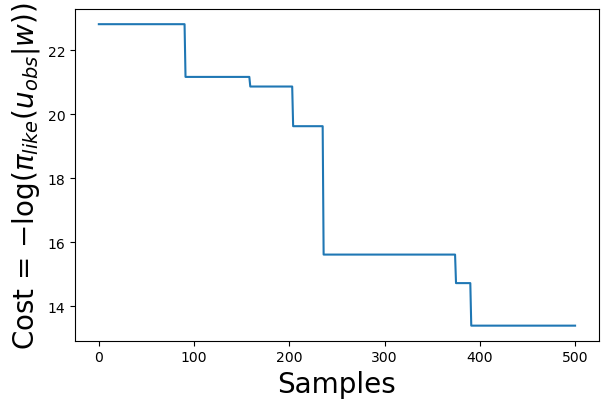

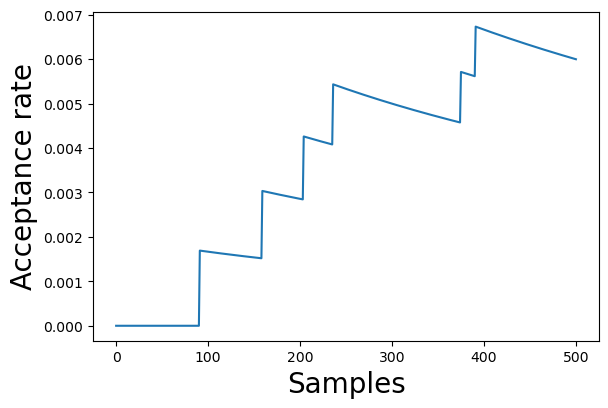

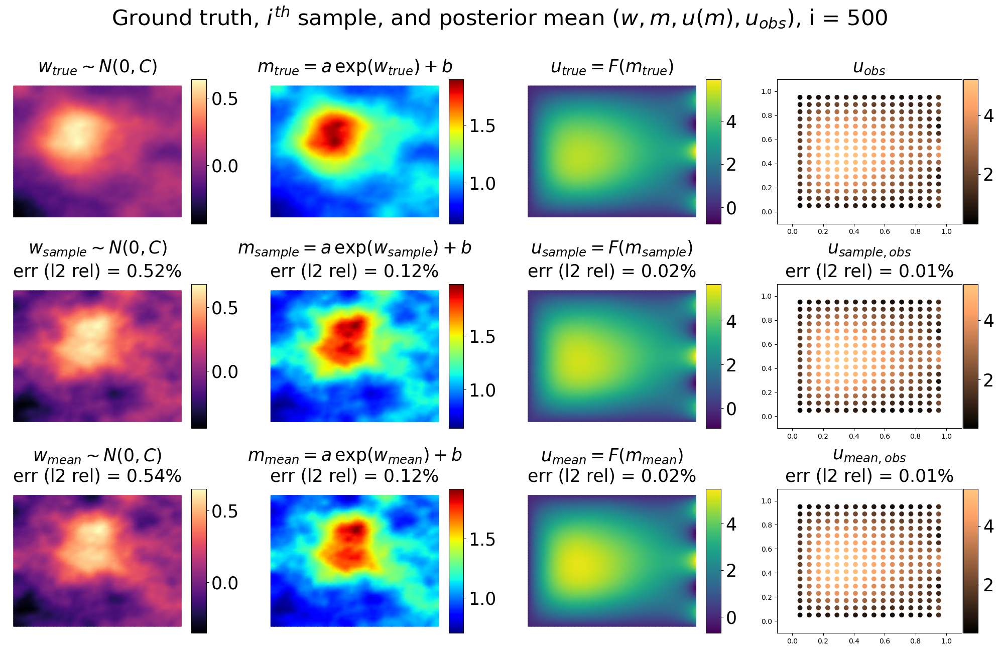

--------------------------------------------------
Sample: 1100, Accepted samples:    7, Acceptance Rate: 6.364e-03, Cost mean: 1.723e+01. 
Tracing 100 samples took 2.331e+01s
Error (%) in w: ||w - w_mean|| = 5.301e+01, ||w - w_sample|| = 5.764e+01
Error (%) in m: ||m - m_mean|| = 1.209e+01, ||m - m_sample|| = 1.307e+01
Error (%) in u: ||u - u_mean|| = 1.571e+00, ||u - u_sample|| = 1.757e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.325e+00, ||u_obs - u_obs_sample|| = 1.533e+00
--------------------------------------------------
--------------------------------------------------
Sample: 1200, Accepted samples:    8, Acceptance Rate: 6.667e-03, Cost mean: 1.669e+01. 
Tracing 100 samples took 1.760e+01s
Error (%) in w: ||w - w_mean|| = 5.236e+01, ||w - w_sample|| = 5.125e+01
Error (%) in m: ||m - m_mean|| = 1.195e+01, ||m - m_sample|| = 1.147e+01
Error (%) in u: ||u - u_mean|| = 1.514e+00, ||u - u_sample|| = 1.597e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.292e+00, ||u_obs - 

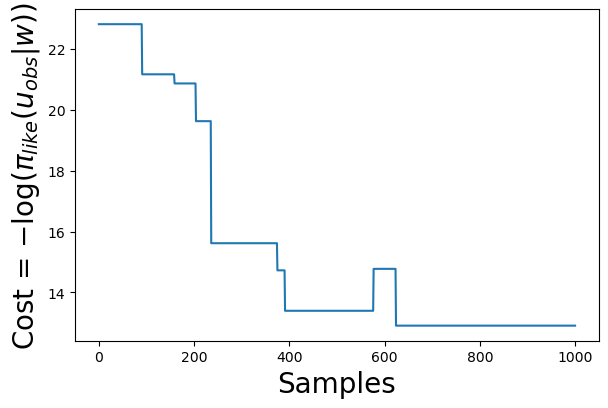

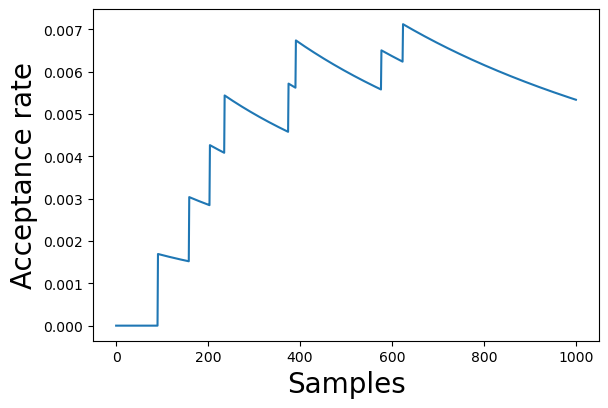

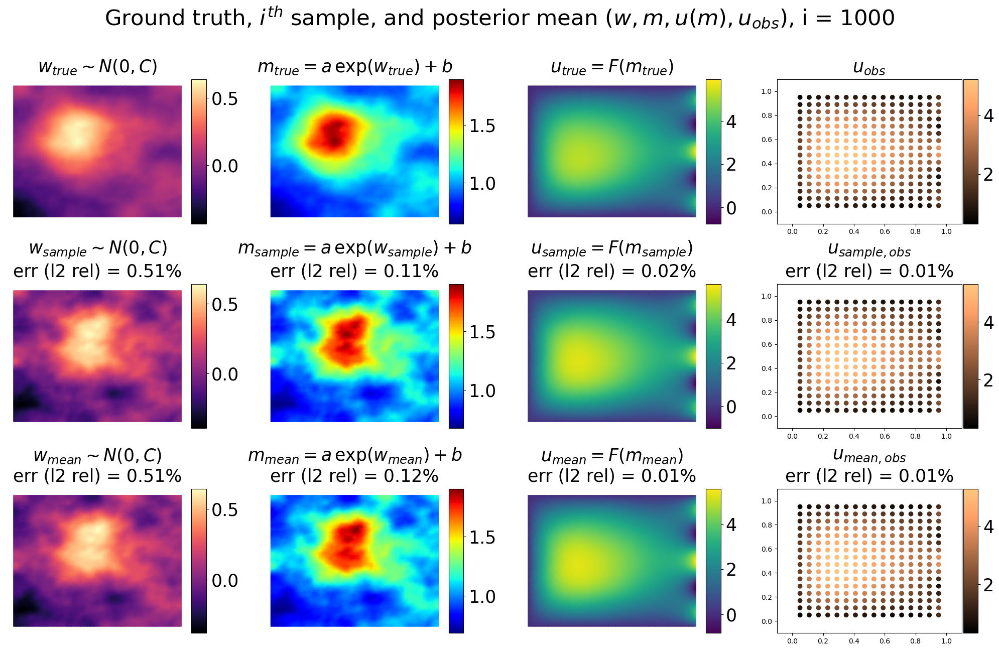

--------------------------------------------------
Sample: 1600, Accepted samples:    8, Acceptance Rate: 5.000e-03, Cost mean: 1.531e+01. 
Tracing 100 samples took 2.451e+01s
Error (%) in w: ||w - w_mean|| = 5.092e+01, ||w - w_sample|| = 5.125e+01
Error (%) in m: ||m - m_mean|| = 1.159e+01, ||m - m_sample|| = 1.147e+01
Error (%) in u: ||u - u_mean|| = 1.426e+00, ||u - u_sample|| = 1.597e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.257e+00, ||u_obs - u_obs_sample|| = 1.433e+00
--------------------------------------------------
--------------------------------------------------
Sample: 1700, Accepted samples:    8, Acceptance Rate: 4.706e-03, Cost mean: 1.511e+01. 
Tracing 100 samples took 1.837e+01s
Error (%) in w: ||w - w_mean|| = 5.081e+01, ||w - w_sample|| = 5.125e+01
Error (%) in m: ||m - m_mean|| = 1.155e+01, ||m - m_sample|| = 1.147e+01
Error (%) in u: ||u - u_mean|| = 1.425e+00, ||u - u_sample|| = 1.597e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.261e+00, ||u_obs - 

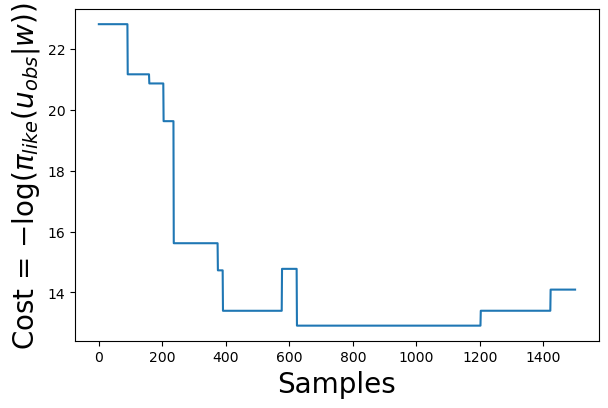

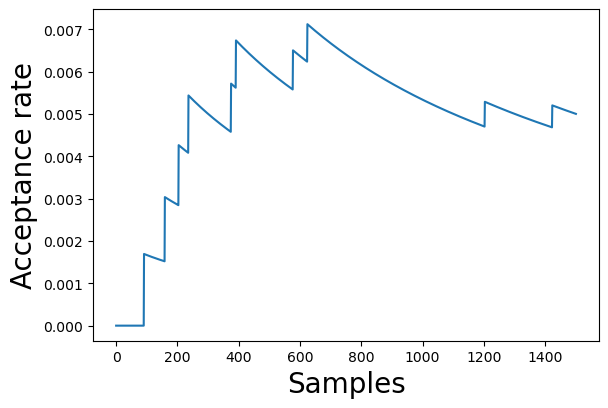

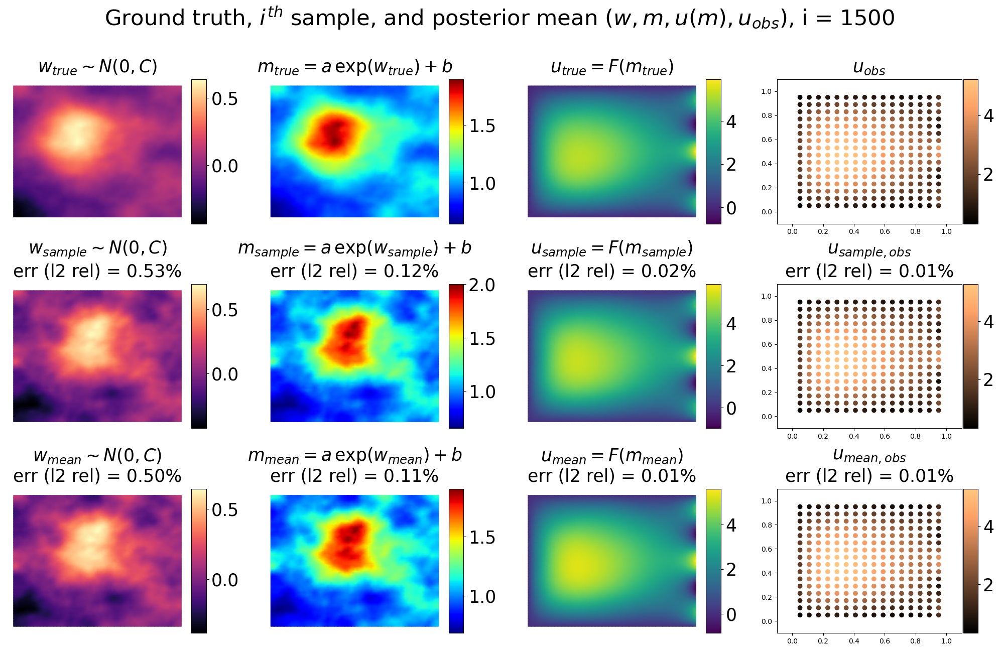

--------------------------------------------------
Sample: 2100, Accepted samples:   11, Acceptance Rate: 5.238e-03, Cost mean: 1.475e+01. 
Tracing 100 samples took 2.616e+01s
Error (%) in w: ||w - w_mean|| = 5.038e+01, ||w - w_sample|| = 5.678e+01
Error (%) in m: ||m - m_mean|| = 1.153e+01, ||m - m_sample|| = 1.326e+01
Error (%) in u: ||u - u_mean|| = 1.397e+00, ||u - u_sample|| = 1.718e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.248e+00, ||u_obs - u_obs_sample|| = 1.565e+00
--------------------------------------------------
--------------------------------------------------
Sample: 2200, Accepted samples:   11, Acceptance Rate: 5.000e-03, Cost mean: 1.479e+01. 
Tracing 100 samples took 1.963e+01s
Error (%) in w: ||w - w_mean|| = 5.047e+01, ||w - w_sample|| = 5.678e+01
Error (%) in m: ||m - m_mean|| = 1.158e+01, ||m - m_sample|| = 1.326e+01
Error (%) in u: ||u - u_mean|| = 1.393e+00, ||u - u_sample|| = 1.718e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.249e+00, ||u_obs - 

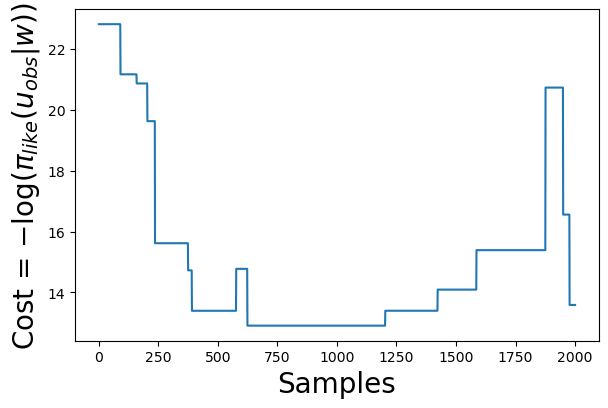

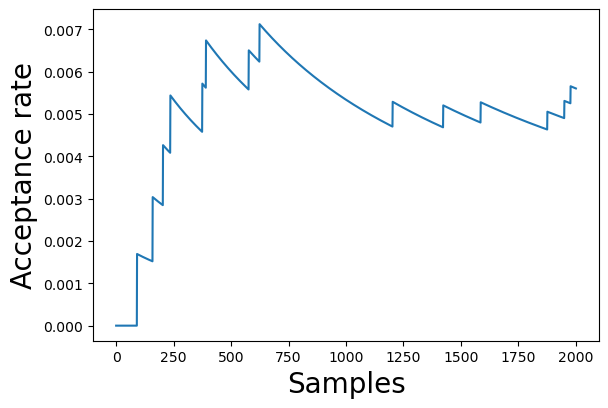

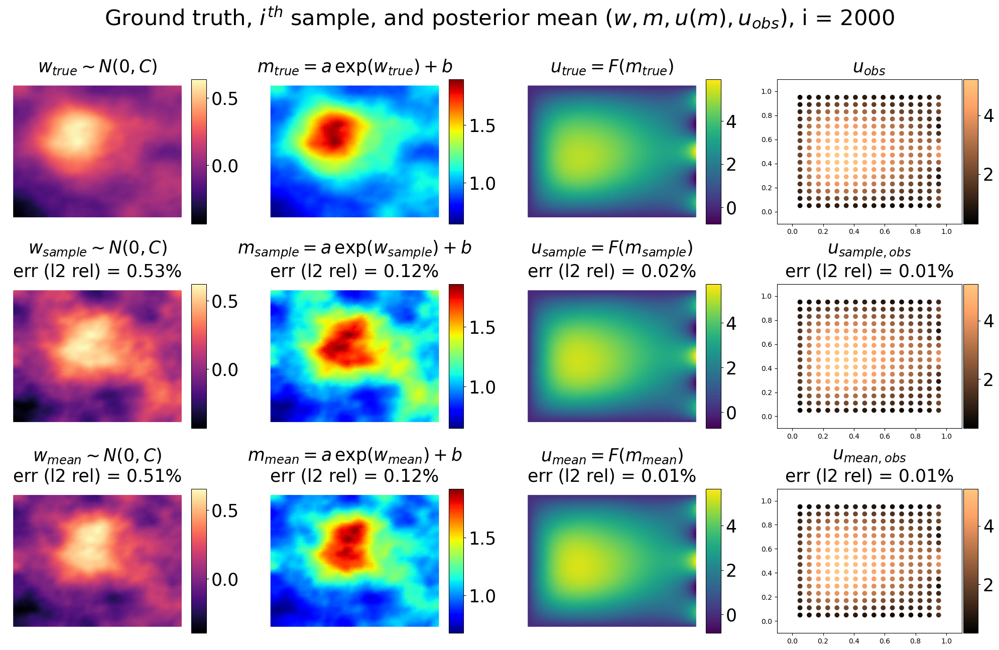

--------------------------------------------------
Sample: 2600, Accepted samples:   15, Acceptance Rate: 5.769e-03, Cost mean: 1.503e+01. 
Tracing 100 samples took 2.652e+01s
Error (%) in w: ||w - w_mean|| = 5.020e+01, ||w - w_sample|| = 4.547e+01
Error (%) in m: ||m - m_mean|| = 1.156e+01, ||m - m_sample|| = 1.010e+01
Error (%) in u: ||u - u_mean|| = 1.378e+00, ||u - u_sample|| = 1.821e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.240e+00, ||u_obs - u_obs_sample|| = 1.591e+00
--------------------------------------------------
--------------------------------------------------
Sample: 2700, Accepted samples:   16, Acceptance Rate: 5.926e-03, Cost mean: 1.504e+01. 
Tracing 100 samples took 2.064e+01s
Error (%) in w: ||w - w_mean|| = 4.965e+01, ||w - w_sample|| = 4.981e+01
Error (%) in m: ||m - m_mean|| = 1.143e+01, ||m - m_sample|| = 1.129e+01
Error (%) in u: ||u - u_mean|| = 1.362e+00, ||u - u_sample|| = 1.659e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.227e+00, ||u_obs - 

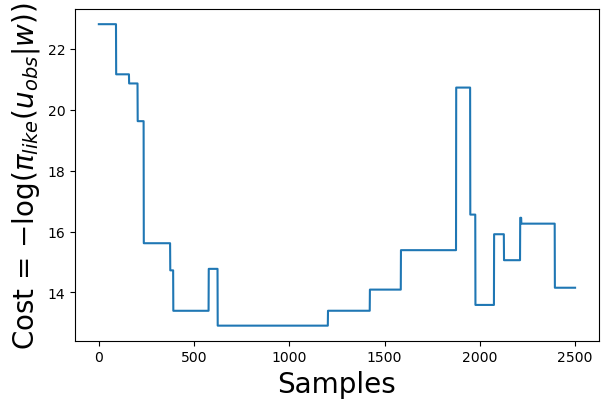

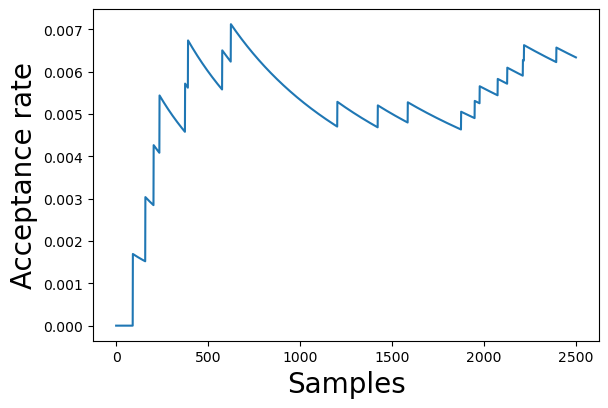

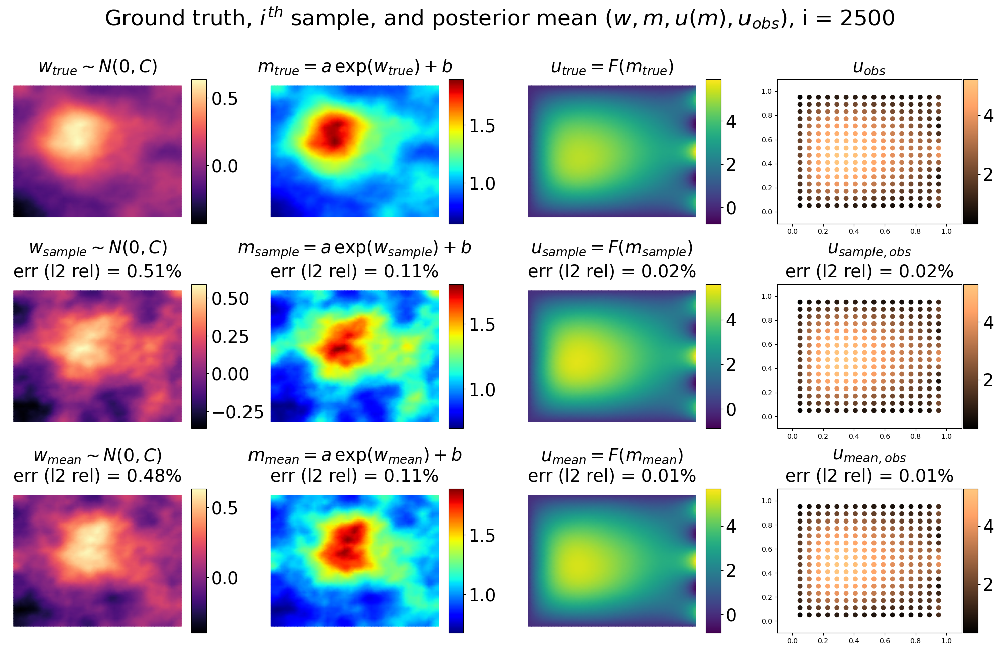

--------------------------------------------------
Sample: 3100, Accepted samples:   19, Acceptance Rate: 6.129e-03, Cost mean: 1.506e+01. 
Tracing 100 samples took 2.732e+01s
Error (%) in w: ||w - w_mean|| = 4.805e+01, ||w - w_sample|| = 5.085e+01
Error (%) in m: ||m - m_mean|| = 1.100e+01, ||m - m_sample|| = 1.108e+01
Error (%) in u: ||u - u_mean|| = 1.338e+00, ||u - u_sample|| = 1.794e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.189e+00, ||u_obs - u_obs_sample|| = 1.501e+00
--------------------------------------------------
--------------------------------------------------
Sample: 3200, Accepted samples:   19, Acceptance Rate: 5.938e-03, Cost mean: 1.503e+01. 
Tracing 100 samples took 2.197e+01s
Error (%) in w: ||w - w_mean|| = 4.784e+01, ||w - w_sample|| = 5.085e+01
Error (%) in m: ||m - m_mean|| = 1.094e+01, ||m - m_sample|| = 1.108e+01
Error (%) in u: ||u - u_mean|| = 1.341e+00, ||u - u_sample|| = 1.794e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.188e+00, ||u_obs - 

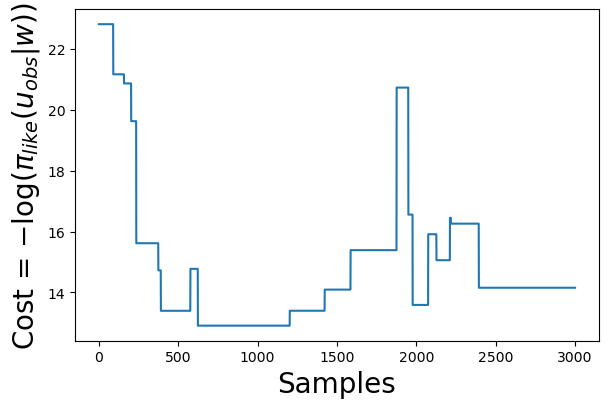

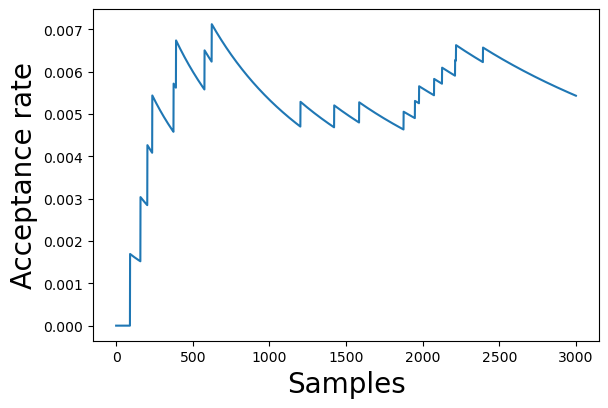

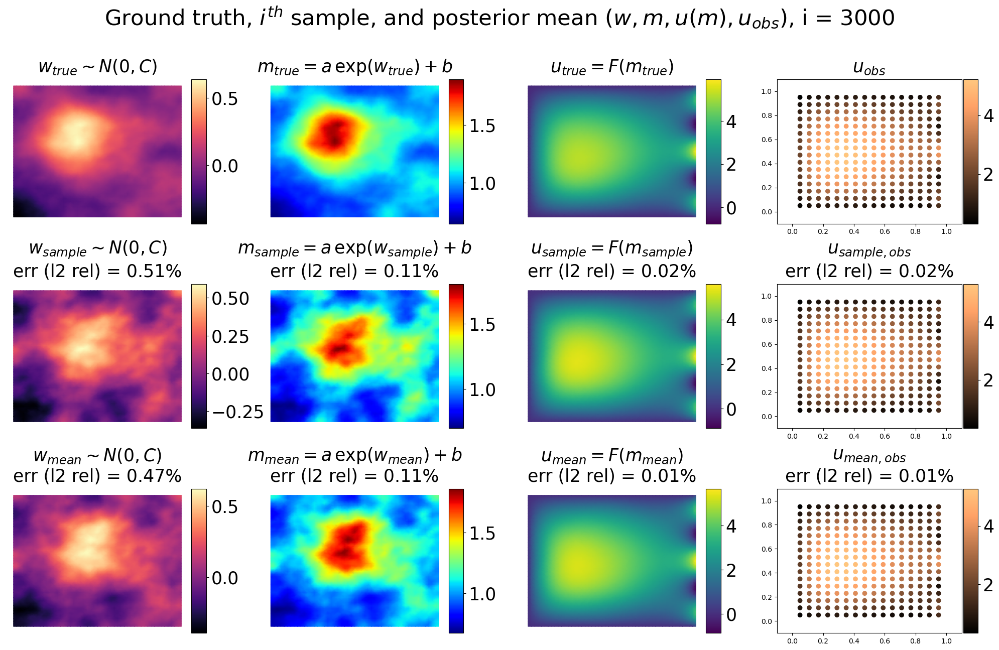

--------------------------------------------------
Sample: 3600, Accepted samples:   19, Acceptance Rate: 5.278e-03, Cost mean: 1.492e+01. 
Tracing 100 samples took 2.969e+01s
Error (%) in w: ||w - w_mean|| = 4.730e+01, ||w - w_sample|| = 5.085e+01
Error (%) in m: ||m - m_mean|| = 1.075e+01, ||m - m_sample|| = 1.108e+01
Error (%) in u: ||u - u_mean|| = 1.360e+00, ||u - u_sample|| = 1.794e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.192e+00, ||u_obs - u_obs_sample|| = 1.501e+00
--------------------------------------------------
--------------------------------------------------
Sample: 3700, Accepted samples:   20, Acceptance Rate: 5.405e-03, Cost mean: 1.490e+01. 
Tracing 100 samples took 2.382e+01s
Error (%) in w: ||w - w_mean|| = 4.723e+01, ||w - w_sample|| = 5.385e+01
Error (%) in m: ||m - m_mean|| = 1.071e+01, ||m - m_sample|| = 1.178e+01
Error (%) in u: ||u - u_mean|| = 1.365e+00, ||u - u_sample|| = 1.866e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.194e+00, ||u_obs - 

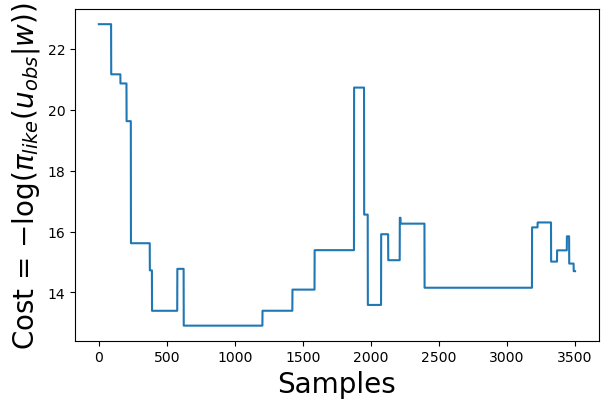

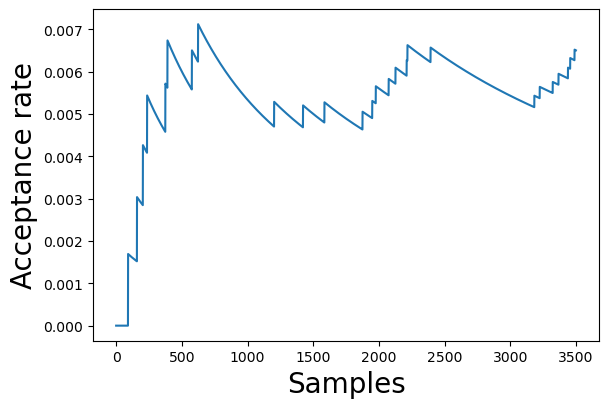

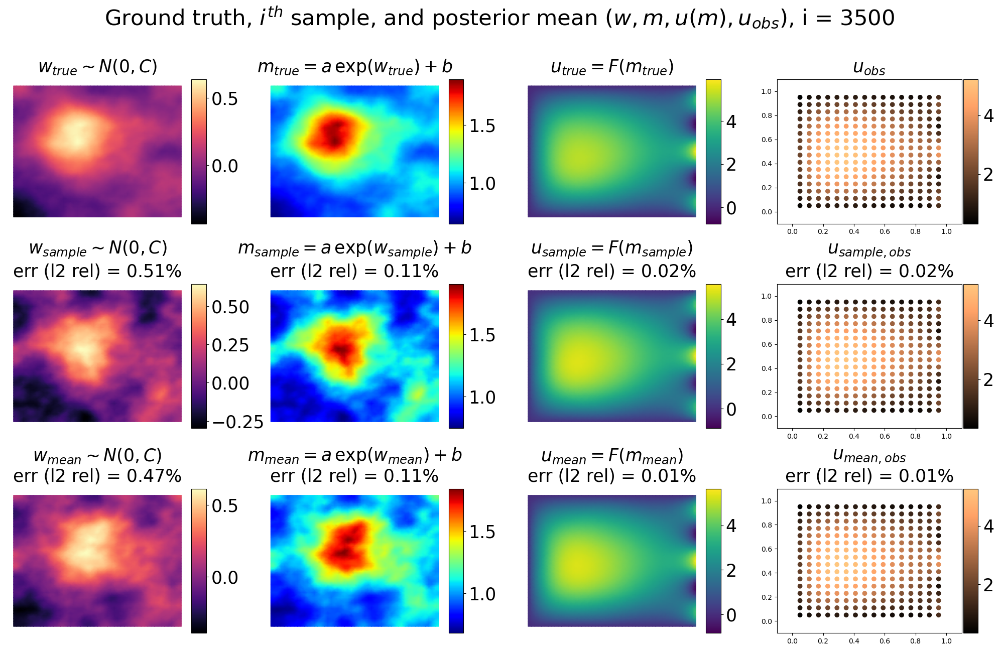

--------------------------------------------------
Sample: 4100, Accepted samples:   27, Acceptance Rate: 6.585e-03, Cost mean: 1.495e+01. 
Tracing 100 samples took 3.073e+01s
Error (%) in w: ||w - w_mean|| = 4.638e+01, ||w - w_sample|| = 4.754e+01
Error (%) in m: ||m - m_mean|| = 1.050e+01, ||m - m_sample|| = 1.007e+01
Error (%) in u: ||u - u_mean|| = 1.355e+00, ||u - u_sample|| = 1.617e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.174e+00, ||u_obs - u_obs_sample|| = 1.403e+00
--------------------------------------------------
--------------------------------------------------
Sample: 4200, Accepted samples:   28, Acceptance Rate: 6.667e-03, Cost mean: 1.491e+01. 
Tracing 100 samples took 2.429e+01s
Error (%) in w: ||w - w_mean|| = 4.578e+01, ||w - w_sample|| = 4.867e+01
Error (%) in m: ||m - m_mean|| = 1.036e+01, ||m - m_sample|| = 1.016e+01
Error (%) in u: ||u - u_mean|| = 1.343e+00, ||u - u_sample|| = 1.767e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.161e+00, ||u_obs - 

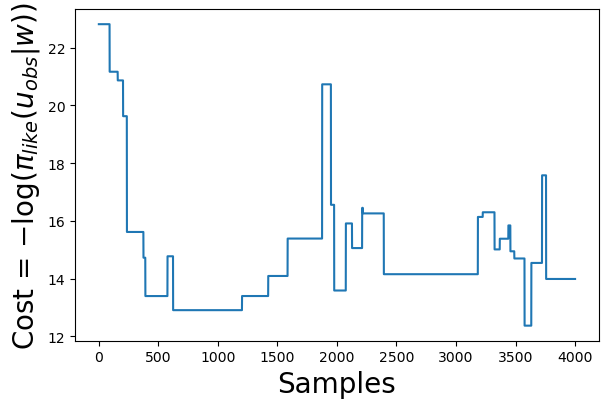

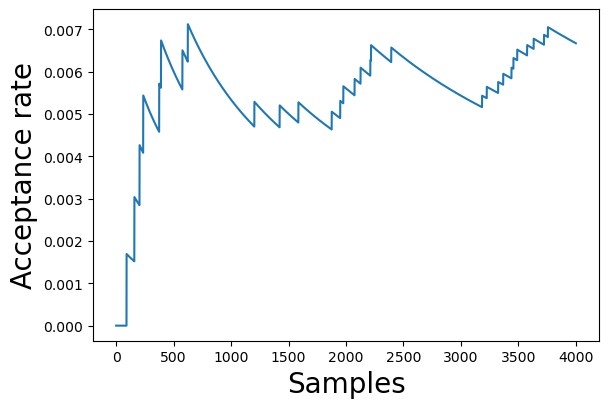

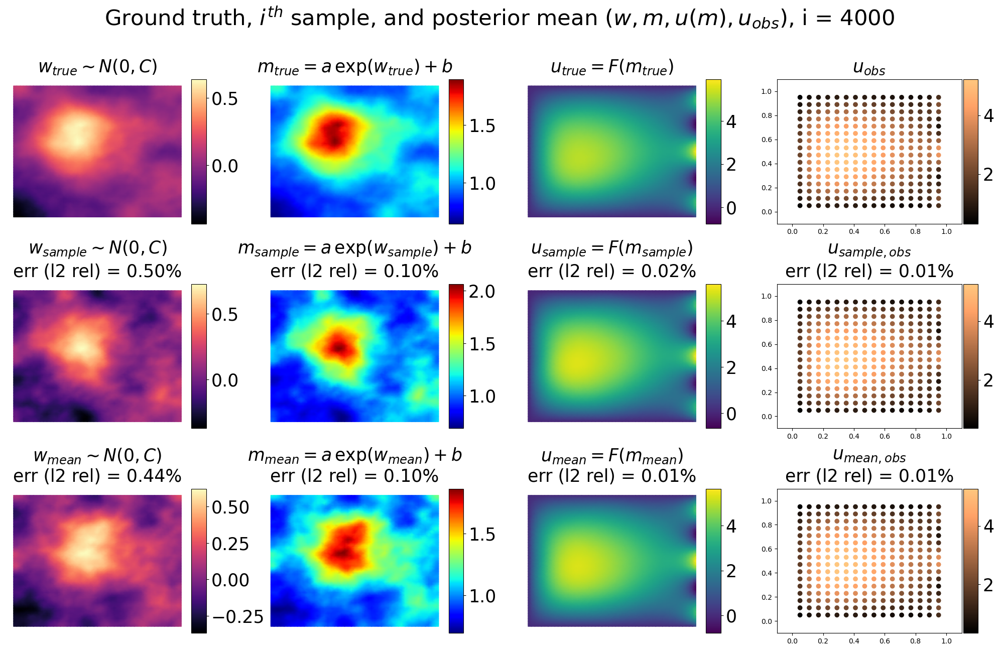

--------------------------------------------------
Sample: 4600, Accepted samples:   30, Acceptance Rate: 6.522e-03, Cost mean: 1.486e+01. 
Tracing 100 samples took 3.131e+01s
Error (%) in w: ||w - w_mean|| = 4.375e+01, ||w - w_sample|| = 4.984e+01
Error (%) in m: ||m - m_mean|| = 9.857e+00, ||m - m_sample|| = 1.021e+01
Error (%) in u: ||u - u_mean|| = 1.318e+00, ||u - u_sample|| = 1.883e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.118e+00, ||u_obs - u_obs_sample|| = 1.492e+00
--------------------------------------------------
--------------------------------------------------
Sample: 4700, Accepted samples:   30, Acceptance Rate: 6.383e-03, Cost mean: 1.484e+01. 
Tracing 100 samples took 2.535e+01s
Error (%) in w: ||w - w_mean|| = 4.337e+01, ||w - w_sample|| = 4.984e+01
Error (%) in m: ||m - m_mean|| = 9.758e+00, ||m - m_sample|| = 1.021e+01
Error (%) in u: ||u - u_mean|| = 1.315e+00, ||u - u_sample|| = 1.883e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.111e+00, ||u_obs - 

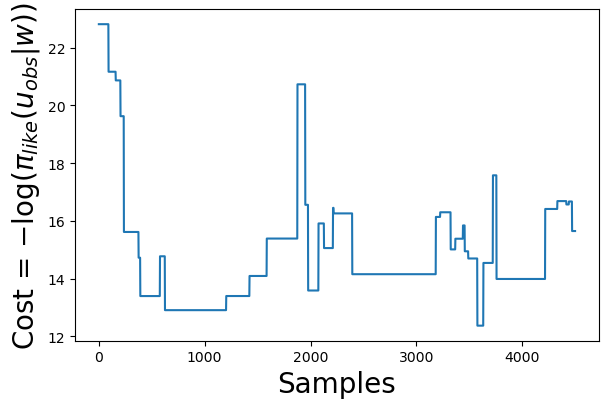

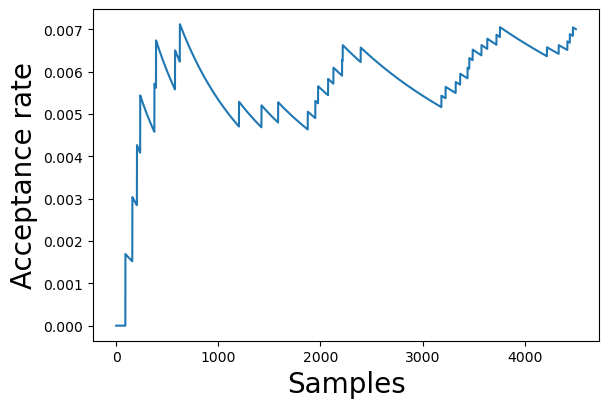

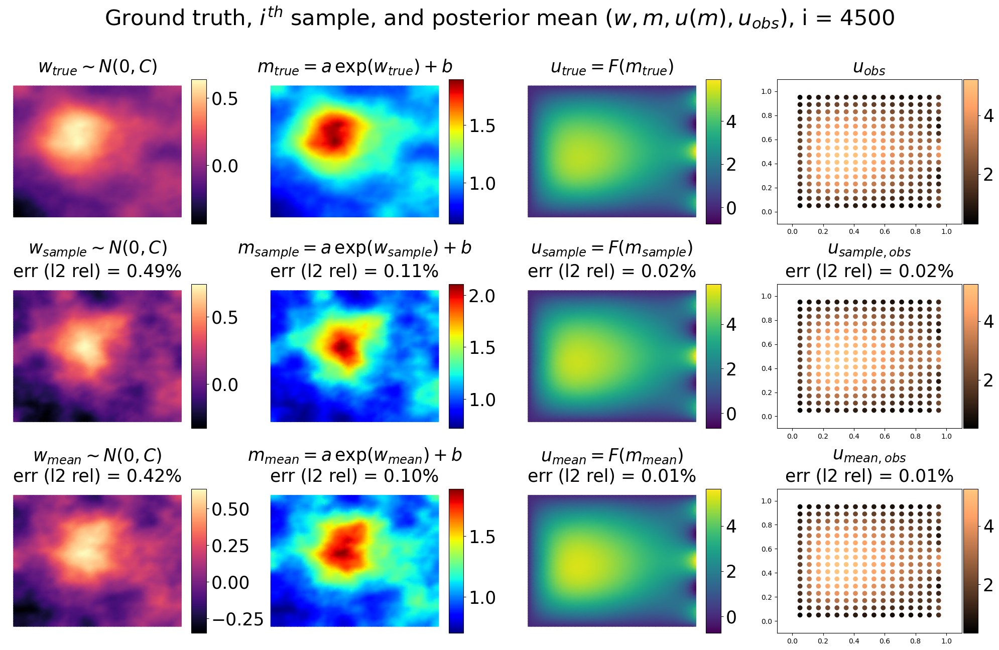

--------------------------------------------------
Sample: 5100, Accepted samples:   36, Acceptance Rate: 7.059e-03, Cost mean: 1.495e+01. 
Tracing 100 samples took 3.186e+01s
Error (%) in w: ||w - w_mean|| = 4.226e+01, ||w - w_sample|| = 4.763e+01
Error (%) in m: ||m - m_mean|| = 9.487e+00, ||m - m_sample|| = 9.872e+00
Error (%) in u: ||u - u_mean|| = 1.312e+00, ||u - u_sample|| = 2.052e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.089e+00, ||u_obs - u_obs_sample|| = 1.707e+00
--------------------------------------------------
--------------------------------------------------
Sample: 5200, Accepted samples:   37, Acceptance Rate: 7.115e-03, Cost mean: 1.499e+01. 
Tracing 100 samples took 2.651e+01s
Error (%) in w: ||w - w_mean|| = 4.201e+01, ||w - w_sample|| = 5.057e+01
Error (%) in m: ||m - m_mean|| = 9.425e+00, ||m - m_sample|| = 1.041e+01
Error (%) in u: ||u - u_mean|| = 1.311e+00, ||u - u_sample|| = 2.002e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.084e+00, ||u_obs - 

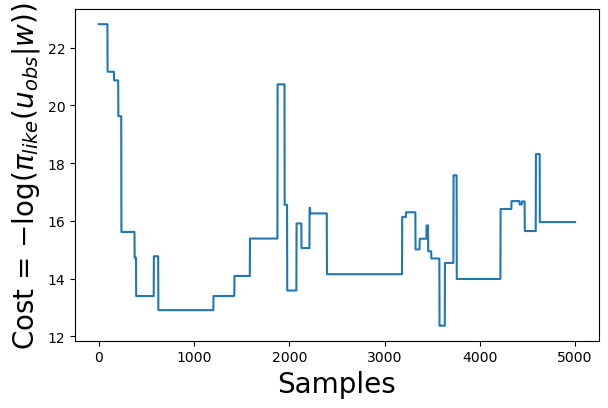

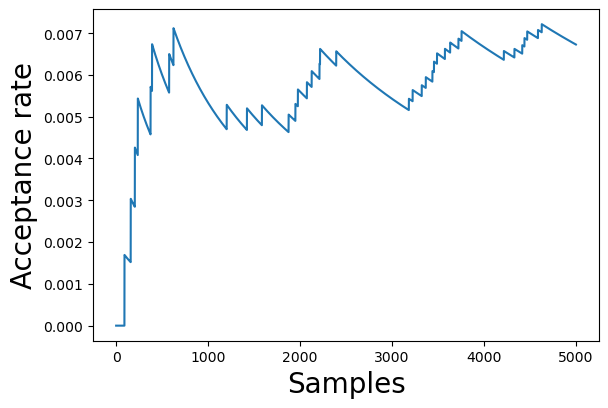

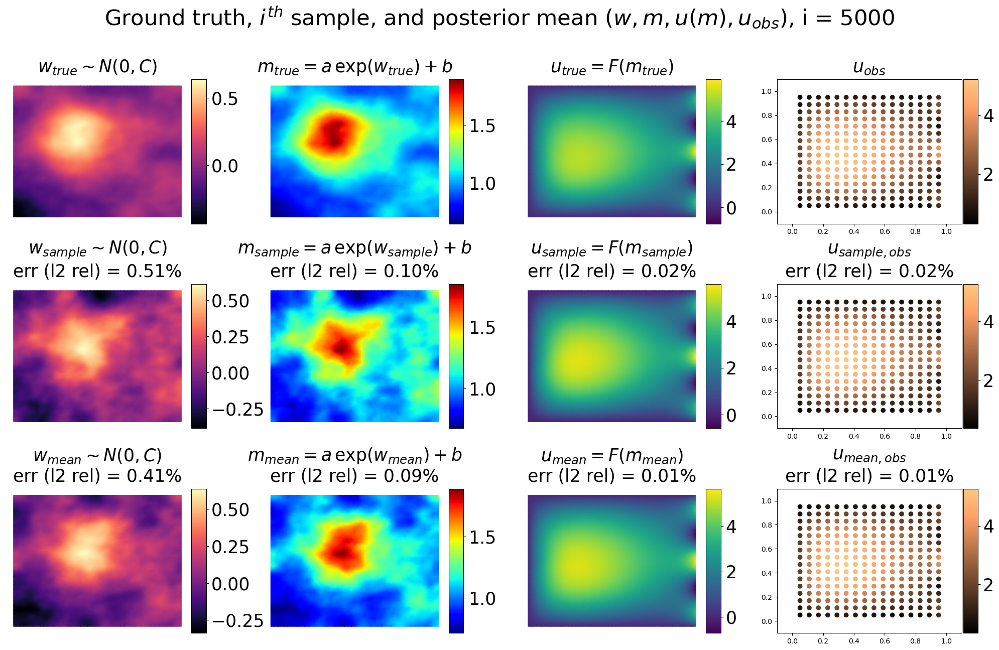

--------------------------------------------------
Sample: 5600, Accepted samples:   37, Acceptance Rate: 6.607e-03, Cost mean: 1.507e+01. 
Tracing 100 samples took 3.350e+01s
Error (%) in w: ||w - w_mean|| = 4.124e+01, ||w - w_sample|| = 5.057e+01
Error (%) in m: ||m - m_mean|| = 9.221e+00, ||m - m_sample|| = 1.041e+01
Error (%) in u: ||u - u_mean|| = 1.312e+00, ||u - u_sample|| = 2.002e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.067e+00, ||u_obs - u_obs_sample|| = 1.593e+00
--------------------------------------------------
--------------------------------------------------
Sample: 5700, Accepted samples:   38, Acceptance Rate: 6.667e-03, Cost mean: 1.508e+01. 
Tracing 100 samples took 2.803e+01s
Error (%) in w: ||w - w_mean|| = 4.108e+01, ||w - w_sample|| = 4.765e+01
Error (%) in m: ||m - m_mean|| = 9.182e+00, ||m - m_sample|| = 1.015e+01
Error (%) in u: ||u - u_mean|| = 1.313e+00, ||u - u_sample|| = 1.853e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.065e+00, ||u_obs - 

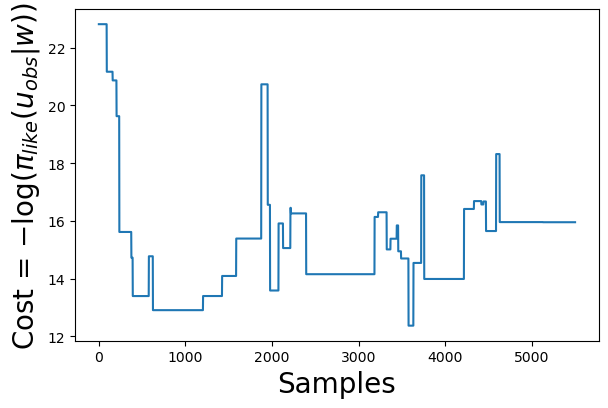

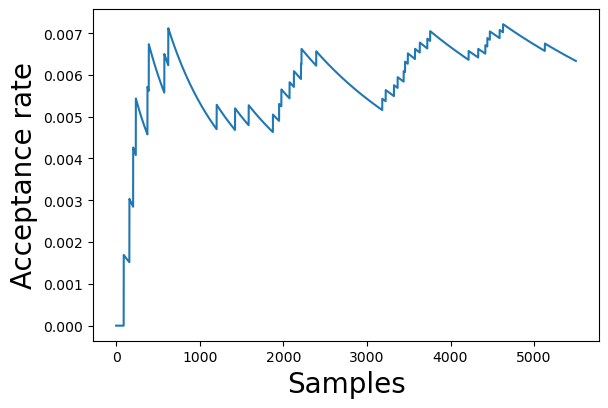

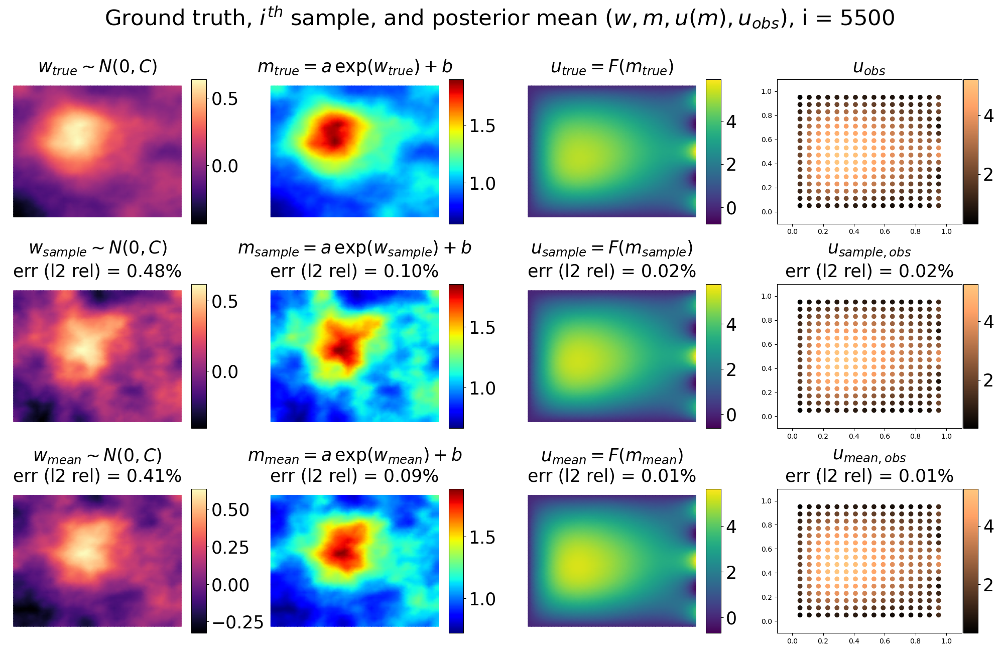

--------------------------------------------------
Sample: 6100, Accepted samples:   39, Acceptance Rate: 6.393e-03, Cost mean: 1.513e+01. 
Tracing 100 samples took 3.413e+01s
Error (%) in w: ||w - w_mean|| = 4.054e+01, ||w - w_sample|| = 5.410e+01
Error (%) in m: ||m - m_mean|| = 9.064e+00, ||m - m_sample|| = 1.139e+01
Error (%) in u: ||u - u_mean|| = 1.316e+00, ||u - u_sample|| = 1.794e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.064e+00, ||u_obs - u_obs_sample|| = 1.540e+00
--------------------------------------------------
--------------------------------------------------
Sample: 6200, Accepted samples:   39, Acceptance Rate: 6.290e-03, Cost mean: 1.513e+01. 
Tracing 100 samples took 2.816e+01s
Error (%) in w: ||w - w_mean|| = 4.050e+01, ||w - w_sample|| = 5.410e+01
Error (%) in m: ||m - m_mean|| = 9.051e+00, ||m - m_sample|| = 1.139e+01
Error (%) in u: ||u - u_mean|| = 1.317e+00, ||u - u_sample|| = 1.794e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.066e+00, ||u_obs - 

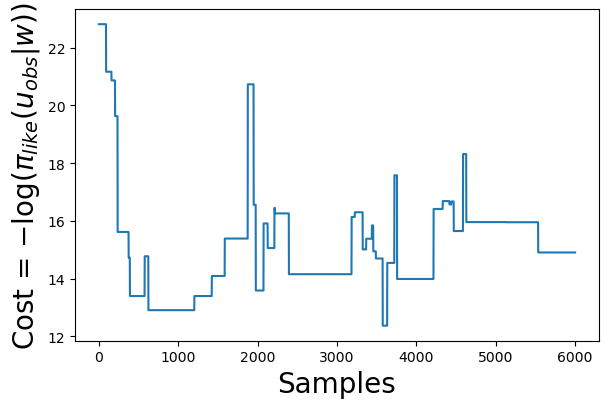

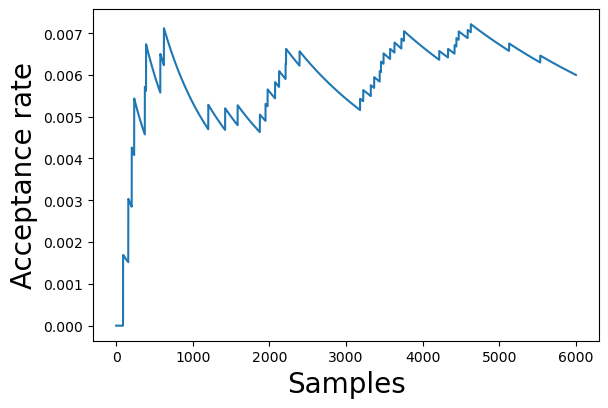

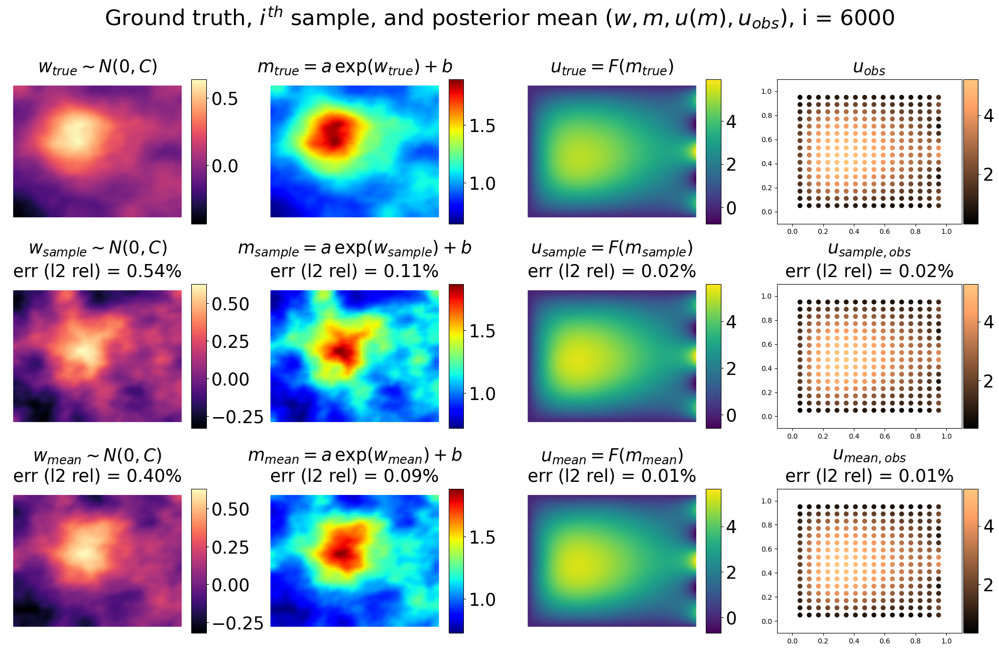

--------------------------------------------------
Sample: 6600, Accepted samples:   39, Acceptance Rate: 5.909e-03, Cost mean: 1.512e+01. 
Tracing 100 samples took 3.516e+01s
Error (%) in w: ||w - w_mean|| = 4.045e+01, ||w - w_sample|| = 5.410e+01
Error (%) in m: ||m - m_mean|| = 9.020e+00, ||m - m_sample|| = 1.139e+01
Error (%) in u: ||u - u_mean|| = 1.324e+00, ||u - u_sample|| = 1.794e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.074e+00, ||u_obs - u_obs_sample|| = 1.540e+00
--------------------------------------------------
--------------------------------------------------
Sample: 6700, Accepted samples:   39, Acceptance Rate: 5.821e-03, Cost mean: 1.511e+01. 
Tracing 100 samples took 2.877e+01s
Error (%) in w: ||w - w_mean|| = 4.046e+01, ||w - w_sample|| = 5.410e+01
Error (%) in m: ||m - m_mean|| = 9.018e+00, ||m - m_sample|| = 1.139e+01
Error (%) in u: ||u - u_mean|| = 1.326e+00, ||u - u_sample|| = 1.794e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.076e+00, ||u_obs - 

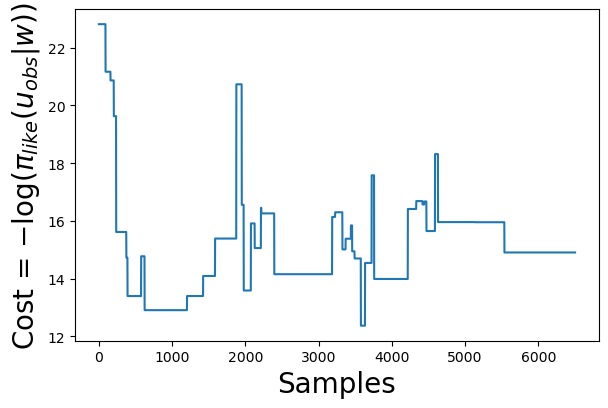

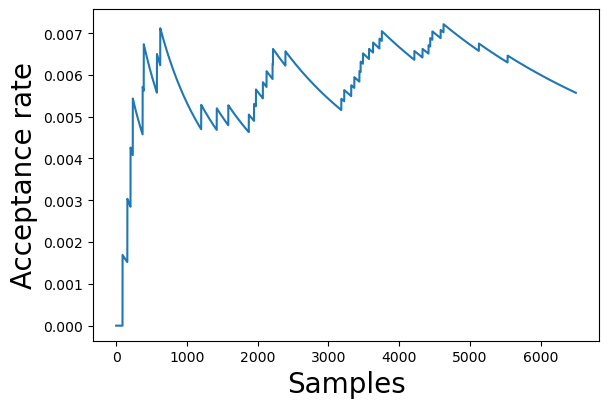

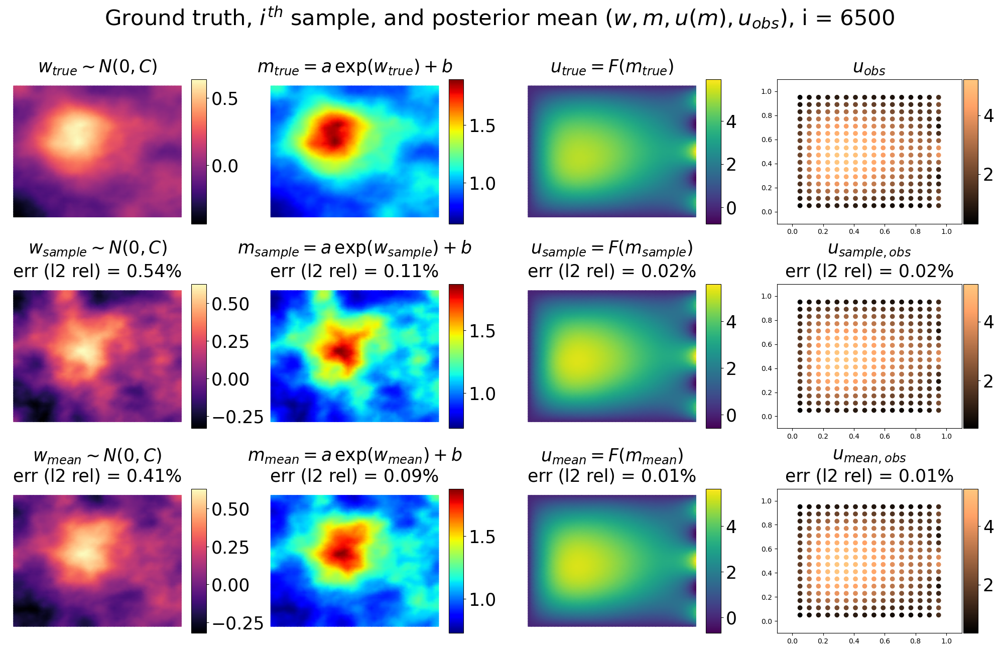

--------------------------------------------------
Sample: 7100, Accepted samples:   40, Acceptance Rate: 5.634e-03, Cost mean: 1.511e+01. 
Tracing 100 samples took 3.566e+01s
Error (%) in w: ||w - w_mean|| = 4.056e+01, ||w - w_sample|| = 5.411e+01
Error (%) in m: ||m - m_mean|| = 9.019e+00, ||m - m_sample|| = 1.131e+01
Error (%) in u: ||u - u_mean|| = 1.335e+00, ||u - u_sample|| = 1.883e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.087e+00, ||u_obs - u_obs_sample|| = 1.627e+00
--------------------------------------------------
--------------------------------------------------
Sample: 7200, Accepted samples:   41, Acceptance Rate: 5.694e-03, Cost mean: 1.511e+01. 
Tracing 100 samples took 3.061e+01s
Error (%) in w: ||w - w_mean|| = 4.053e+01, ||w - w_sample|| = 5.306e+01
Error (%) in m: ||m - m_mean|| = 9.003e+00, ||m - m_sample|| = 1.112e+01
Error (%) in u: ||u - u_mean|| = 1.334e+00, ||u - u_sample|| = 1.640e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.088e+00, ||u_obs - 

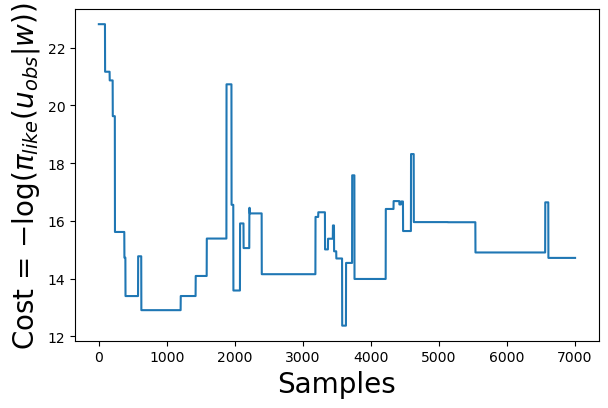

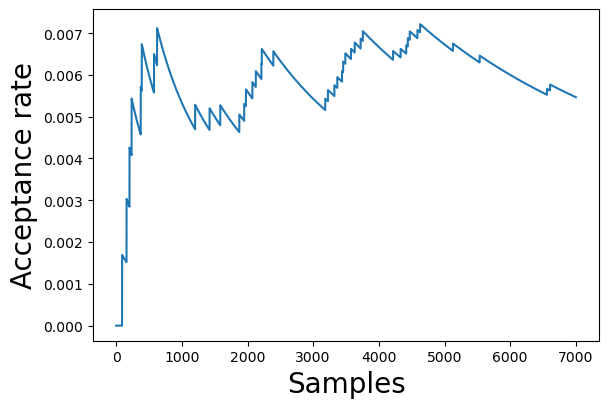

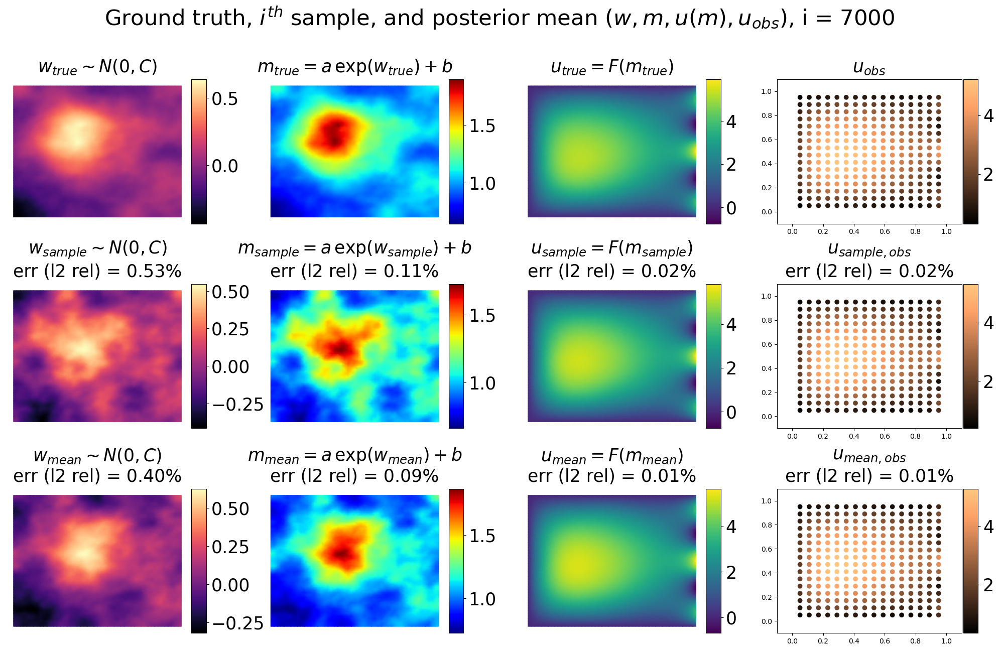

--------------------------------------------------
Sample: 7600, Accepted samples:   42, Acceptance Rate: 5.526e-03, Cost mean: 1.509e+01. 
Tracing 100 samples took 3.672e+01s
Error (%) in w: ||w - w_mean|| = 4.039e+01, ||w - w_sample|| = 5.310e+01
Error (%) in m: ||m - m_mean|| = 8.944e+00, ||m - m_sample|| = 1.085e+01
Error (%) in u: ||u - u_mean|| = 1.327e+00, ||u - u_sample|| = 1.645e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.091e+00, ||u_obs - u_obs_sample|| = 1.566e+00
--------------------------------------------------
--------------------------------------------------
Sample: 7700, Accepted samples:   43, Acceptance Rate: 5.584e-03, Cost mean: 1.510e+01. 
Tracing 100 samples took 3.073e+01s
Error (%) in w: ||w - w_mean|| = 4.038e+01, ||w - w_sample|| = 5.698e+01
Error (%) in m: ||m - m_mean|| = 8.940e+00, ||m - m_sample|| = 1.210e+01
Error (%) in u: ||u - u_mean|| = 1.323e+00, ||u - u_sample|| = 1.830e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.089e+00, ||u_obs - 

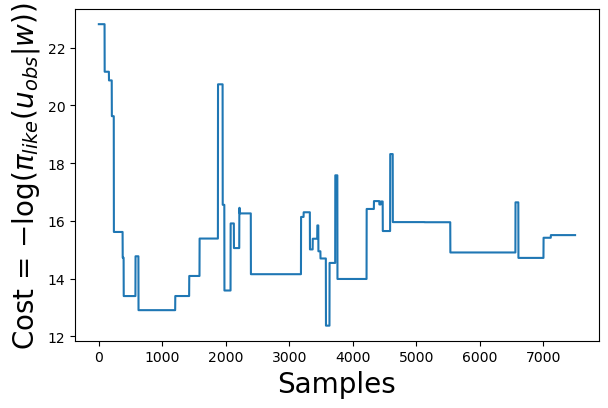

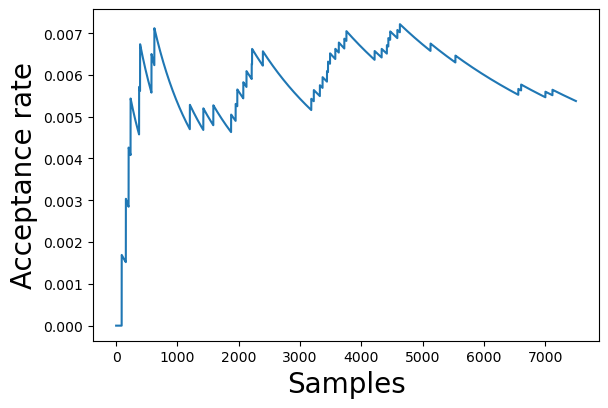

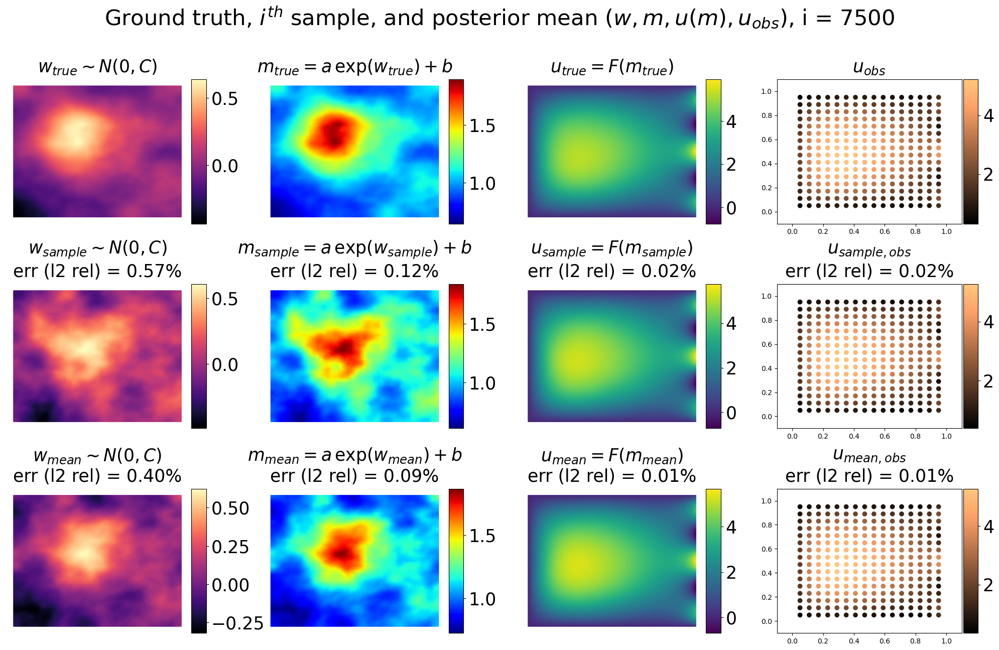

--------------------------------------------------
Sample: 8100, Accepted samples:   43, Acceptance Rate: 5.309e-03, Cost mean: 1.512e+01. 
Tracing 100 samples took 3.765e+01s
Error (%) in w: ||w - w_mean|| = 4.045e+01, ||w - w_sample|| = 5.698e+01
Error (%) in m: ||m - m_mean|| = 8.952e+00, ||m - m_sample|| = 1.210e+01
Error (%) in u: ||u - u_mean|| = 1.312e+00, ||u - u_sample|| = 1.830e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.082e+00, ||u_obs - u_obs_sample|| = 1.571e+00
--------------------------------------------------
--------------------------------------------------
Sample: 8200, Accepted samples:   43, Acceptance Rate: 5.244e-03, Cost mean: 1.513e+01. 
Tracing 100 samples took 3.172e+01s
Error (%) in w: ||w - w_mean|| = 4.048e+01, ||w - w_sample|| = 5.698e+01
Error (%) in m: ||m - m_mean|| = 8.957e+00, ||m - m_sample|| = 1.210e+01
Error (%) in u: ||u - u_mean|| = 1.310e+00, ||u - u_sample|| = 1.830e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.081e+00, ||u_obs - 

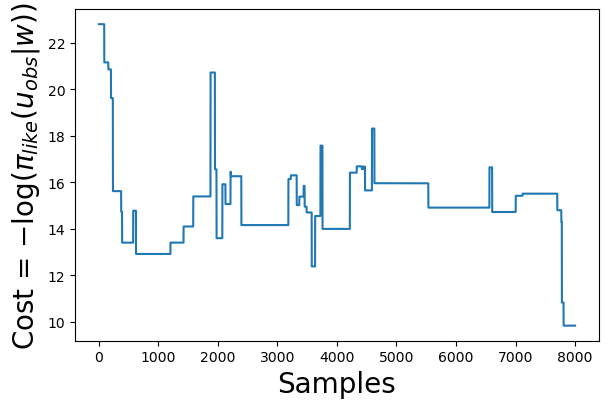

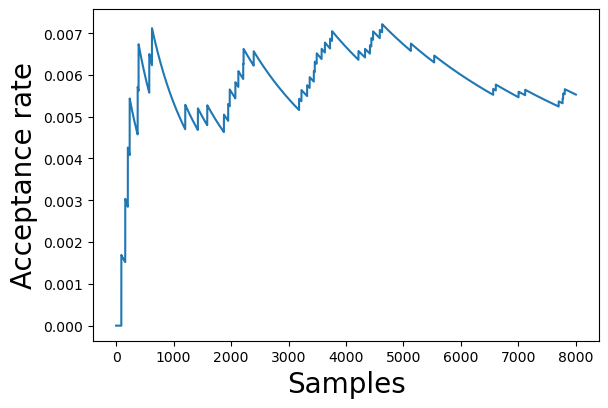

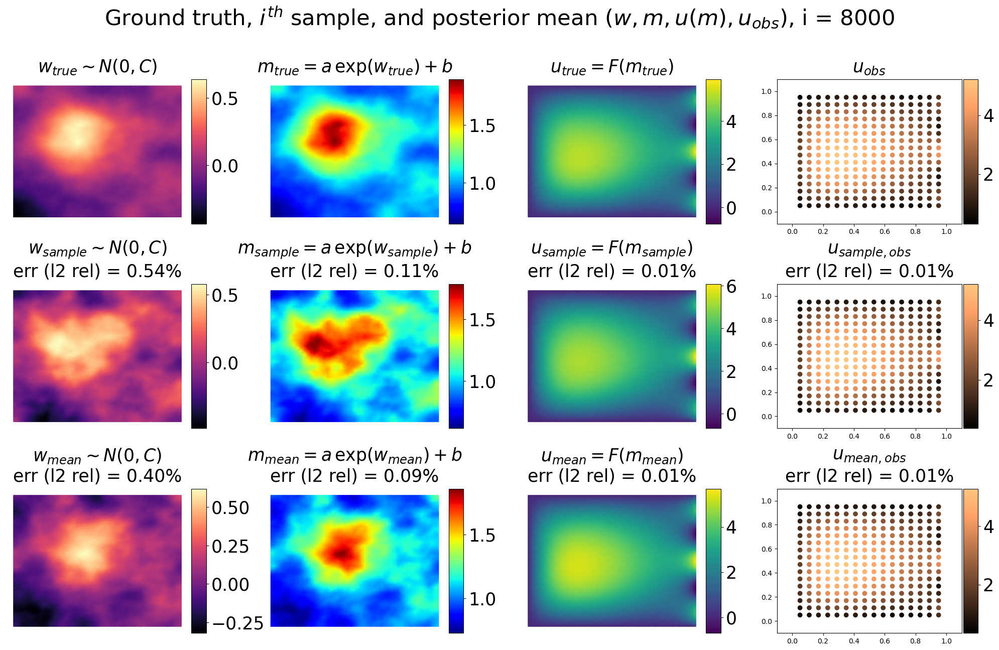

--------------------------------------------------
Sample: 8600, Accepted samples:   47, Acceptance Rate: 5.465e-03, Cost mean: 1.492e+01. 
Tracing 100 samples took 3.823e+01s
Error (%) in w: ||w - w_mean|| = 3.994e+01, ||w - w_sample|| = 5.357e+01
Error (%) in m: ||m - m_mean|| = 8.818e+00, ||m - m_sample|| = 1.089e+01
Error (%) in u: ||u - u_mean|| = 1.269e+00, ||u - u_sample|| = 1.382e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.052e+00, ||u_obs - u_obs_sample|| = 1.250e+00
--------------------------------------------------
--------------------------------------------------
Sample: 8700, Accepted samples:   48, Acceptance Rate: 5.517e-03, Cost mean: 1.487e+01. 
Tracing 100 samples took 3.274e+01s
Error (%) in w: ||w - w_mean|| = 3.982e+01, ||w - w_sample|| = 5.449e+01
Error (%) in m: ||m - m_mean|| = 8.784e+00, ||m - m_sample|| = 1.137e+01
Error (%) in u: ||u - u_mean|| = 1.259e+00, ||u - u_sample|| = 1.727e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.045e+00, ||u_obs - 

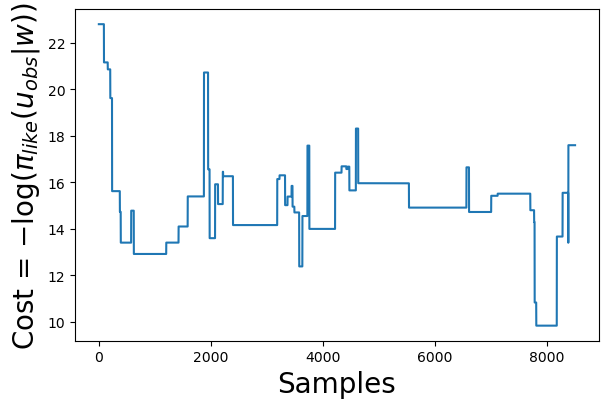

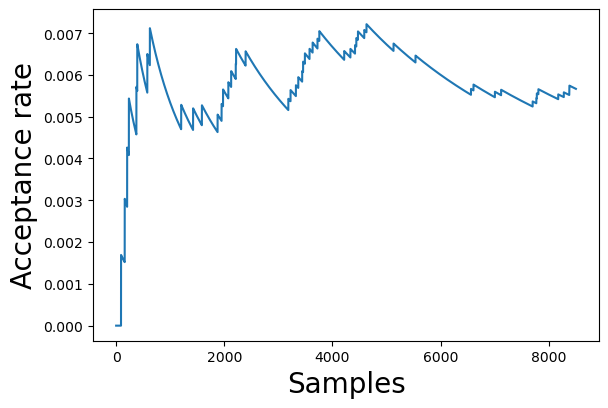

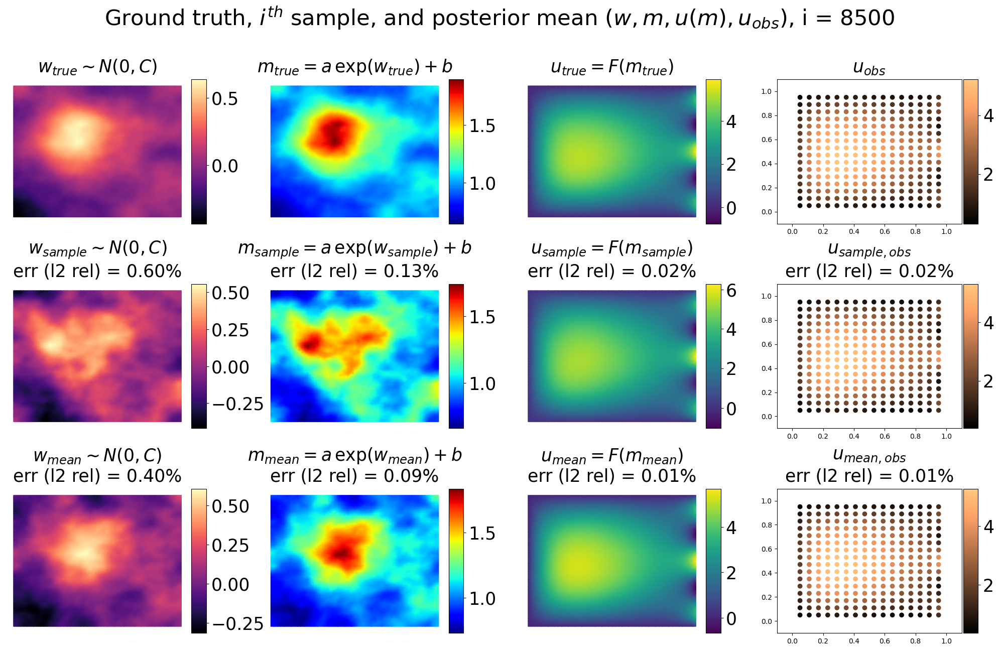

--------------------------------------------------
Sample: 9100, Accepted samples:   52, Acceptance Rate: 5.714e-03, Cost mean: 1.494e+01. 
Tracing 100 samples took 4.029e+01s
Error (%) in w: ||w - w_mean|| = 3.950e+01, ||w - w_sample|| = 5.982e+01
Error (%) in m: ||m - m_mean|| = 8.697e+00, ||m - m_sample|| = 1.247e+01
Error (%) in u: ||u - u_mean|| = 1.228e+00, ||u - u_sample|| = 1.906e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.028e+00, ||u_obs - u_obs_sample|| = 1.786e+00
--------------------------------------------------
--------------------------------------------------
Sample: 9200, Accepted samples:   56, Acceptance Rate: 6.087e-03, Cost mean: 1.496e+01. 
Tracing 100 samples took 3.411e+01s
Error (%) in w: ||w - w_mean|| = 3.937e+01, ||w - w_sample|| = 6.034e+01
Error (%) in m: ||m - m_mean|| = 8.664e+00, ||m - m_sample|| = 1.317e+01
Error (%) in u: ||u - u_mean|| = 1.221e+00, ||u - u_sample|| = 1.728e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.024e+00, ||u_obs - 

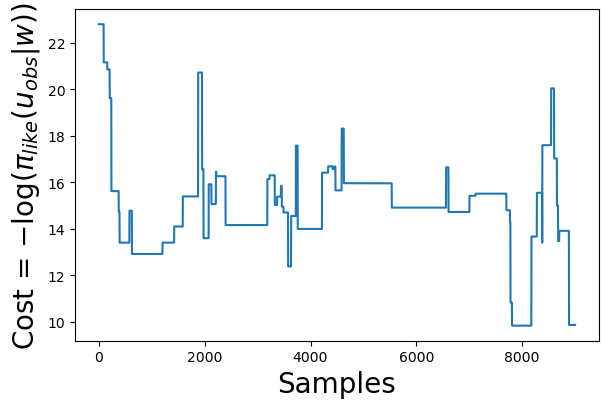

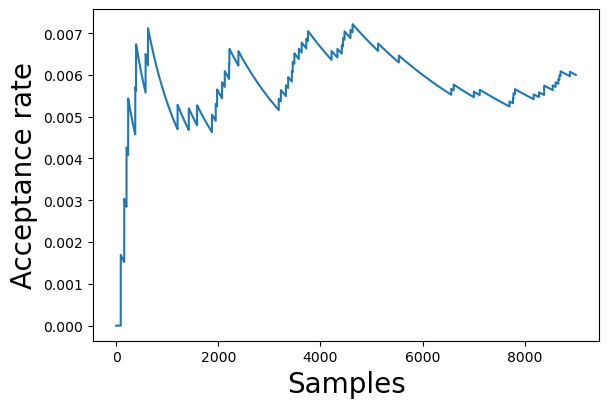

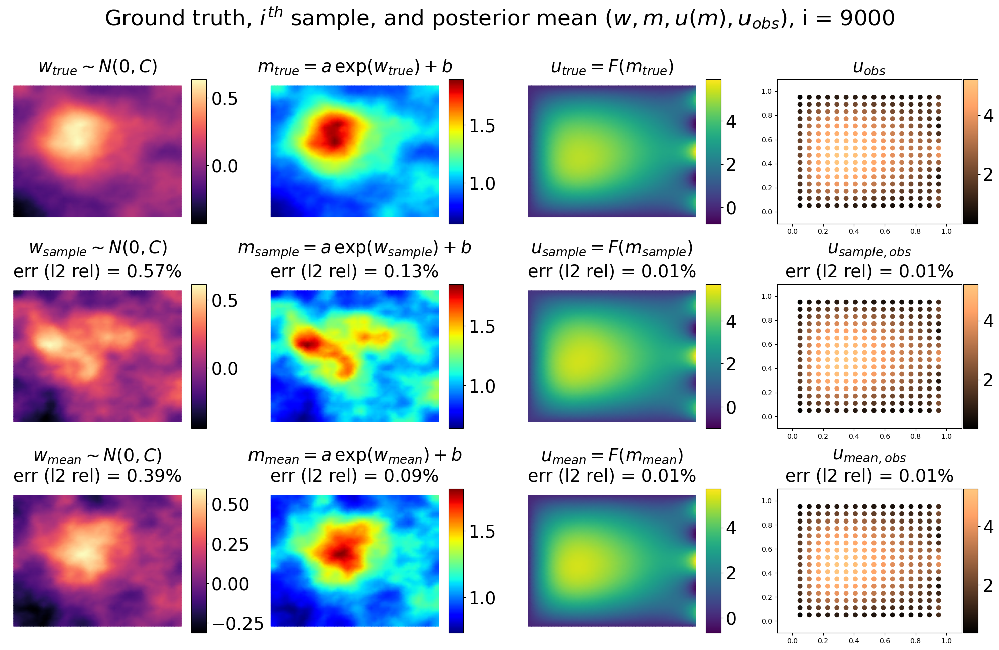

--------------------------------------------------
Sample: 9600, Accepted samples:   57, Acceptance Rate: 5.938e-03, Cost mean: 1.482e+01. 
Tracing 100 samples took 4.056e+01s
Error (%) in w: ||w - w_mean|| = 3.912e+01, ||w - w_sample|| = 5.742e+01
Error (%) in m: ||m - m_mean|| = 8.607e+00, ||m - m_sample|| = 1.269e+01
Error (%) in u: ||u - u_mean|| = 1.201e+00, ||u - u_sample|| = 1.488e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.010e+00, ||u_obs - u_obs_sample|| = 1.252e+00
--------------------------------------------------
--------------------------------------------------
Sample: 9700, Accepted samples:   57, Acceptance Rate: 5.876e-03, Cost mean: 1.477e+01. 
Tracing 100 samples took 3.469e+01s
Error (%) in w: ||w - w_mean|| = 3.905e+01, ||w - w_sample|| = 5.742e+01
Error (%) in m: ||m - m_mean|| = 8.596e+00, ||m - m_sample|| = 1.269e+01
Error (%) in u: ||u - u_mean|| = 1.195e+00, ||u - u_sample|| = 1.488e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 1.006e+00, ||u_obs - 

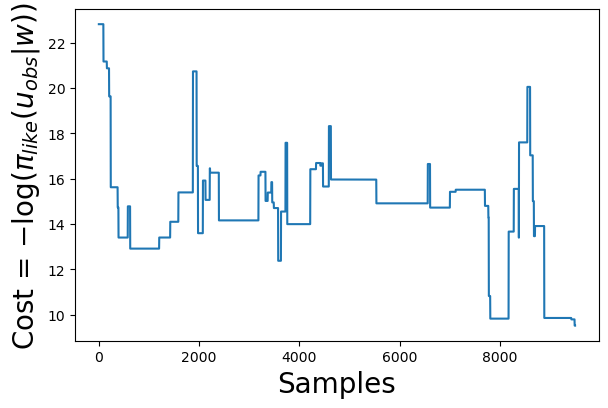

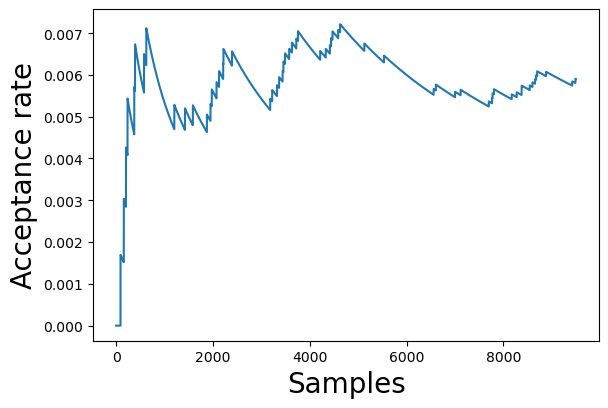

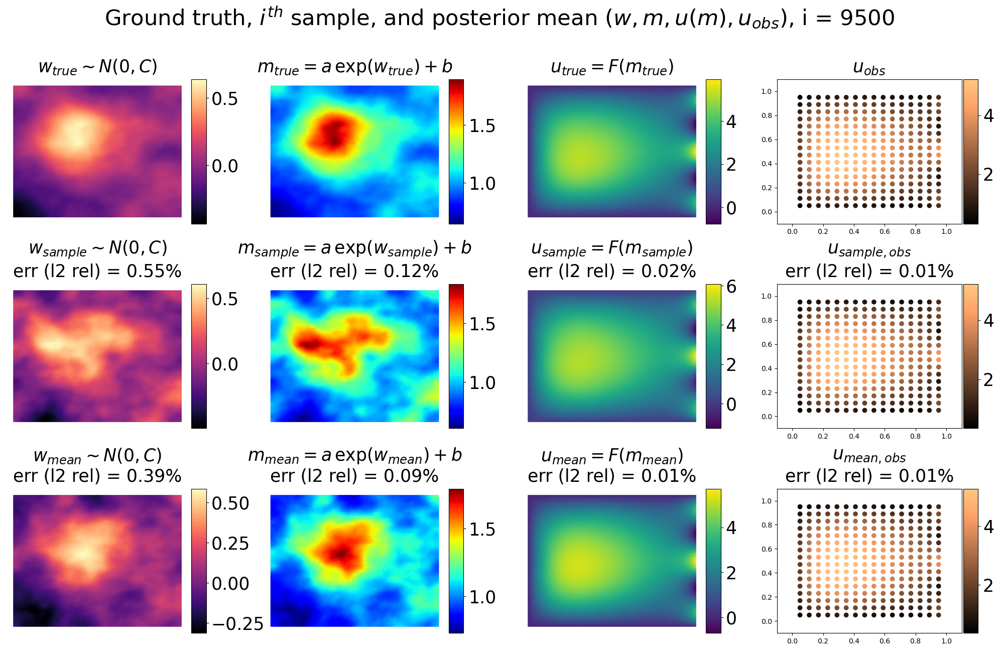

--------------------------------------------------
Sample: 10100, Accepted samples:   59, Acceptance Rate: 5.842e-03, Cost mean: 1.456e+01. 
Tracing 100 samples took 4.290e+01s
Error (%) in w: ||w - w_mean|| = 3.878e+01, ||w - w_sample|| = 5.458e+01
Error (%) in m: ||m - m_mean|| = 8.541e+00, ||m - m_sample|| = 1.158e+01
Error (%) in u: ||u - u_mean|| = 1.170e+00, ||u - u_sample|| = 1.580e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 9.880e-01, ||u_obs - u_obs_sample|| = 1.230e+00
--------------------------------------------------
--------------------------------------------------
Sample: 10200, Accepted samples:   59, Acceptance Rate: 5.784e-03, Cost mean: 1.450e+01. 
Tracing 100 samples took 3.617e+01s
Error (%) in w: ||w - w_mean|| = 3.870e+01, ||w - w_sample|| = 5.458e+01
Error (%) in m: ||m - m_mean|| = 8.522e+00, ||m - m_sample|| = 1.158e+01
Error (%) in u: ||u - u_mean|| = 1.162e+00, ||u - u_sample|| = 1.580e+00
Error (%) in u_obs: ||u_obs - u_obs_mean|| = 9.833e-01, ||u_obs 

In [64]:
n_samples = 10000
n_burnin = 500
pcn_beta = 0.25
print_every = 100
display_plot_every = 5*print_every

if mcmc.surrogate_to_use is not None:
    savepath = results_dir + 'mcmc_results_n_samples_{:4d}_n_burnin_{:4d}_pcn_beta_{:.3f}_sigma_{:.3e}'.format(n_samples, n_burnin, pcn_beta, sigma_noise) + '_surrogate_{}/'.format(mcmc.surrogate_to_use)
else:
    savepath = results_dir + 'mcmc_results_n_samples_{:4d}_n_burnin_{:4d}_pcn_beta_{:.3f}_sigma_{:.3e}'.format(n_samples, n_burnin, pcn_beta, sigma_noise) + '/'

os.makedirs(savepath, exist_ok = True)

savefilename = 'tracer'

mcmc.run(n_samples = n_samples, n_burnin = n_burnin, \
         pcn_beta = pcn_beta, sigma_noise = sigma_noise, \
         print_every = print_every, print_lvl = 2, \
         display_plot_every = display_plot_every, \
         savefilename = savefilename, \
         savepath = savepath)

In [ ]:
mcmc.tracer.acceptances

162

# Plotting

In [ ]:
s = compute_sample_errors(mcmc)
print(s)

Error (%) in w: ||w - w_mean|| = 3.202e+01, ||w - w_sample|| = 5.188e+01
Error (%) in m: ||m - m_mean|| = 6.967e+00, ||m - m_sample|| = 1.079e+01
Error (%) in u: ||u - u_mean|| = 8.820e-01, ||u - u_sample|| = 1.557e+00


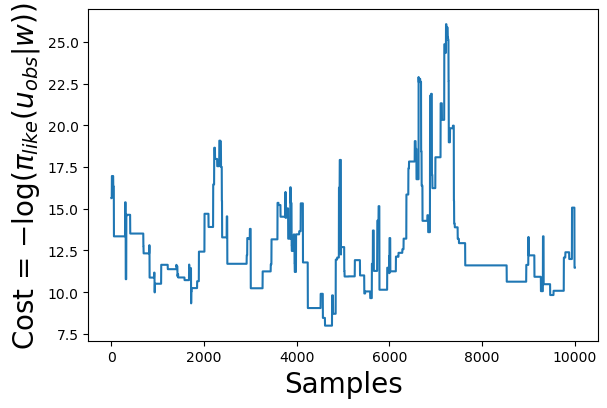

In [ ]:
savefig = False
plot_curve(mcmc.tracer.accepted_samples_cost, xl=r'Samples', \
        yl= r'Cost = $-\log(\pi_{like}(u_{obs} | w))$', \
        fs = 20, lw = 3, \
        savefig = savefig, figsize=[6,4])

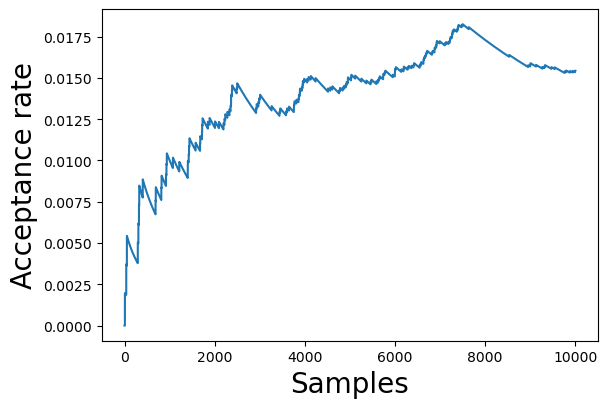

In [ ]:
savefig = False
plot_curve(mcmc.tracer.acceptance_rate, xl=r'Samples', \
        yl= r'Acceptance rate', \
        fs = 20, lw = 3, \
        savefig = savefig, figsize=[6,4])

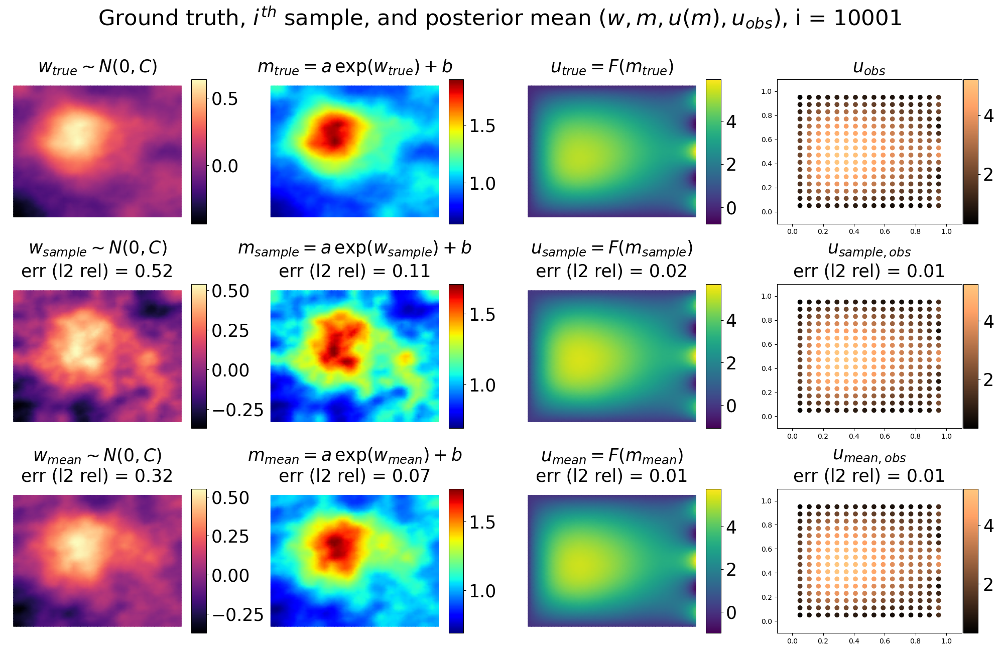

In [ ]:
w_mean = mcmc.tracer.accepted_samples_mean_m
w_sample_i = len(mcmc.tracer.accepted_samples_m) - 1
w_sample = mcmc.tracer.accepted_samples_m[w_sample_i]

plot_fields_base(w_mean, w_sample, w_sample_i, mcmc, savefilename = None)

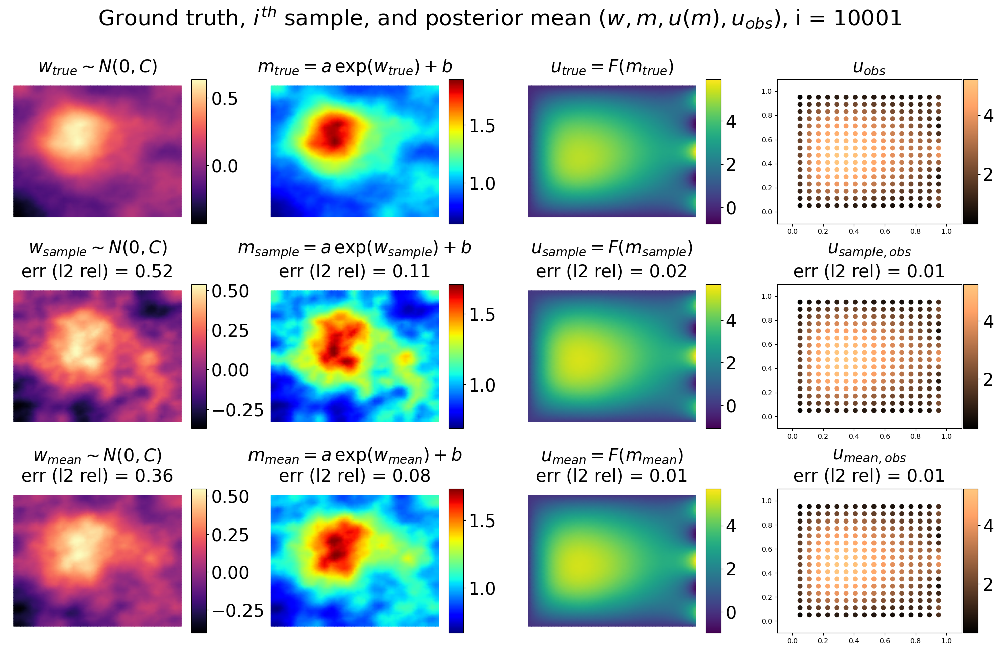

In [ ]:
nsamples = len(mcmc.tracer.accepted_samples_m)
ignore_n = int(0.3 * nsamples)
ignore_end_n = int((1. - 0.) * nsamples)
w_mean = np.mean(mcmc.tracer.accepted_samples_m[ignore_n:ignore_end_n, :], axis = 0)
w_sample_i = len(mcmc.tracer.accepted_samples_m) - 1
w_sample = mcmc.tracer.accepted_samples_m[w_sample_i]

save_sf = True
plot_sf = mcmc.tracer.savepath + 'true_and_posterior_mean_w_m_u_remove_{}_samples_iter_{}.png'.format(ignore_n, nsamples)
plot_fields_base(w_mean, w_sample, w_sample_i, mcmc, savefilename = plot_sf if save_sf else None)

In [ ]:
mcmc_data = np.load(savepath + savefilename + '.npz')
mcmc_data['sigma_noise']

array(0.13925562)